In [437]:
import time
from fuzzywuzzy import fuzz

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer,CountVectorizer
from sklearn.manifold import TSNE
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from gensim.models.word2vec import Word2Vec
from konlpy.tag import Okt
from konlpy.tag import Mecab
# from khaiii import KhaiiiApi
import numpy as np
from collections import Counter
import re
import networkx as nx

from wordcloud import WordCloud
from PIL import ImageFont, ImageDraw

import matplotlib.pyplot as plt

from matplotlib import font_manager

import warnings
warnings.simplefilter("ignore")

In [438]:
# 재해개요 Data Load
df = pd.read_excel("/Users/seop/Desktop/3-2/연구실/제조업 화재. 폭발사고 데이터(1.819건) (1).xlsx")
# df
# df = pd.read_excel("제조업 화재. 폭발사고 데이터(1.819건) (1).xlsx")
df

,연번,기준연월,발생형태_소,재해개요
0,43,201212,화재,주조사업장내 가우징 작업장에서 롤초크 안쪽에 붙어있는 소착을 제거하기 위해서 가우징...
1,120,201212,폭발·파열,[비보고 사유] 가스주입실에서 이송대기중 질소가스통 체결부위 불량으로 폭발되면서 파...
2,197,201212,폭발·파열,[비보고 사유] 재해 발생시 산업재해발생 보고를 해야 한다는 사실을 알지 못함 [조...
3,394,201212,폭발·파열,[비보고 사유] 재해자가 본인 실수로 다쳤으므로 본인이 알아서 한다고 하여 방치한 ...
4,478,201212,폭발·파열,[비보고 사유] 공상처리 [조사자 견해] 유성기업(주)에서 제출한 공상처리 내역 및...
...,...,...,...,...
1814,495010,201712,화재,상기일 상기인 호스를 연결하기 위해 녹이는 과정에서 사고가 발생.(신나에 불이 옮겨...
1815,495567,201712,화재,12월 07일 오전07시경 제품(무거리) 보관용기로 사용하기 위해 폐드럼통 뚜껑 산...
1816,495930,201712,폭발·파열,2017년 12월 12일 14시 48분경 회사 공장동에서 기계시운전을 하면서 온도상...
1817,496127,201712,화재,2017년 12월 18일 13시경 부산시 강서구 송정동 소재 부광화학공업(주) 본공...


In [439]:
df = df.drop_duplicates(['재해개요'], keep='first')
df

,연번,기준연월,발생형태_소,재해개요
0,43,201212,화재,주조사업장내 가우징 작업장에서 롤초크 안쪽에 붙어있는 소착을 제거하기 위해서 가우징...
1,120,201212,폭발·파열,[비보고 사유] 가스주입실에서 이송대기중 질소가스통 체결부위 불량으로 폭발되면서 파...
2,197,201212,폭발·파열,[비보고 사유] 재해 발생시 산업재해발생 보고를 해야 한다는 사실을 알지 못함 [조...
3,394,201212,폭발·파열,[비보고 사유] 재해자가 본인 실수로 다쳤으므로 본인이 알아서 한다고 하여 방치한 ...
4,478,201212,폭발·파열,[비보고 사유] 공상처리 [조사자 견해] 유성기업(주)에서 제출한 공상처리 내역 및...
...,...,...,...,...
1813,494817,201712,폭발·파열,사업장내 개발공실 옆 외부에서 민수 신호기 개발용 추진제 작업 중 고체추진제 홀 구...
1814,495010,201712,화재,상기일 상기인 호스를 연결하기 위해 녹이는 과정에서 사고가 발생.(신나에 불이 옮겨...
1815,495567,201712,화재,12월 07일 오전07시경 제품(무거리) 보관용기로 사용하기 위해 폐드럼통 뚜껑 산...
1816,495930,201712,폭발·파열,2017년 12월 12일 14시 48분경 회사 공장동에서 기계시운전을 하면서 온도상...


In [440]:
df_화재 = df[df["발생형태_소"] == "화재"]
df_폭파 = df[df["발생형태_소"] == "폭발·파열"]
화재_post = df_화재.get("재해개요")
폭파_post = df_폭파.get("재해개요")
폭파_post
df_화재

,연번,기준연월,발생형태_소,재해개요
0,43,201212,화재,주조사업장내 가우징 작업장에서 롤초크 안쪽에 붙어있는 소착을 제거하기 위해서 가우징...
5,636,201212,화재,[비보고 사유] 약 10일간의 입원치료로서 병원비를 회사에서 지급하였고 퇴원 후 조...
6,672,201212,화재,[비보고 사유] 개인 휴가중에 발생한 개인적 업무를 보다 발생한 사고라서 생각하여 ...
7,963,201212,화재,[비보고 사유] 이천만원 이하 공사인 관계로 산재처리 되지 않는다고 하여서 [조사자...
8,1388,201212,화재,[비보고 사유] 최초에 4일간의 통원치료 진단을 받았으나 가료 중 상처부위가 덧나 ...
...,...,...,...,...
1807,491279,201712,화재,2017. 11. 8. 14:40경 경기도 파주시 파주읍 정문로 720(부곡리497...
1810,493755,201712,화재,2017. 11. 22. 13:44.경 그라비아인쇄기 가동을 위한 준비작업을 하던더...
1814,495010,201712,화재,상기일 상기인 호스를 연결하기 위해 녹이는 과정에서 사고가 발생.(신나에 불이 옮겨...
1815,495567,201712,화재,12월 07일 오전07시경 제품(무거리) 보관용기로 사용하기 위해 폐드럼통 뚜껑 산...


In [441]:
화재_post = 화재_post.reset_index().drop('index',axis=1)
폭파_post = 폭파_post.reset_index().drop('index',axis=1)

In [442]:
화재_post

,재해개요
0,주조사업장내 가우징 작업장에서 롤초크 안쪽에 붙어있는 소착을 제거하기 위해서 가우징...
1,[비보고 사유] 약 10일간의 입원치료로서 병원비를 회사에서 지급하였고 퇴원 후 조...
2,[비보고 사유] 개인 휴가중에 발생한 개인적 업무를 보다 발생한 사고라서 생각하여 ...
3,[비보고 사유] 이천만원 이하 공사인 관계로 산재처리 되지 않는다고 하여서 [조사자...
4,[비보고 사유] 최초에 4일간의 통원치료 진단을 받았으나 가료 중 상처부위가 덧나 ...
...,...
935,2017. 11. 8. 14:40경 경기도 파주시 파주읍 정문로 720(부곡리497...
936,2017. 11. 22. 13:44.경 그라비아인쇄기 가동을 위한 준비작업을 하던더...
937,상기일 상기인 호스를 연결하기 위해 녹이는 과정에서 사고가 발생.(신나에 불이 옮겨...
938,12월 07일 오전07시경 제품(무거리) 보관용기로 사용하기 위해 폐드럼통 뚜껑 산...


In [443]:
# 불용어 정의
df_stopwords = pd.read_excel('stopwords.xlsx')
df_stopwords

,불용어
0,아
1,휴
2,아이구
3,아이쿠
4,아이고
...,...
1146,외부
1147,작업
1148,중
1149,분경


# 화재에 대한 네트워크 시각화

In [444]:
# 명사부분 추출
sentence_list = []
morphs_list = []

# from eunjeon import Mecab
tagger = Mecab()
sentence_nouns_list = []
for post in 화재_post['재해개요']:
    print(post)
    morphs_value = []
    for noun in tagger.nouns(post):
        if noun not in list(df_stopwords.get("불용어")):
            if len(noun) == 1:
                    noun = noun+'_'
            morphs_list.append(noun)

            morphs_value.append(noun)
    sentence_nouns_list.append(morphs_value)

주조사업장내 가우징 작업장에서 롤초크 안쪽에 붙어있는 소착을 제거하기 위해서 가우징 기계를 이용하여 작업하던 중 가우징 불똥이 내경 단차부위에 두딪혀 작업자 쪽으로 뛰어 점퍼에 불이 붙었으나, 방독마스크와 용접면을 쓰고 있어서 불이 붙은 줄 모르다가 늦게 인지하여 왼쪽팔과 가슴쪽에 화염화상을 입음.
[비보고 사유] 약 10일간의 입원치료로서 병원비를 회사에서 지급하였고 퇴원 후 조속히 업무에 복귀함에 따라 별다른 생각없이 보고하지 아니 함. [조사자 견해] 관련지침 및 감독관집무규정에 따라 경고조치코자 함 [작업장소] 위 사업장내 PET생산라인 현장에서 [작업목적] 수지게이트 노즐구멍을 오픈하기 위해 [작업도구] 휴대용 토치를 사용 [작업내용] 토치가 기계모서리에 찍히면서 [재해사유] 원재료에 불이 붙어 [재해발생] 팔목과 팔꿈치 사이에 화상을 입음
[비보고 사유] 개인 휴가중에 발생한 개인적 업무를 보다 발생한 사고라서 생각하여 산재처리를 하지 않음  [조사자 견해] 산재처리 여부 확인서, 재해자의 사유서,산업재해조사표 및 재해자 진단서 등에 의거 고의성이 없는 것으로 판단되고, 2011.5.19. 이전 조치기준에 의거 요양기준이 84일 미만이고 최근 3년 이내에 동일 사안 위반내역이 없으므로 이번에 한해 경고처분으로 종결코자 함 [작업장소] 2010년 6월29일 김천 구성면 소재 냇가에서 [작업목적] 고기를 굽기위해 [작업도구] LPG 가스기기에  [작업내용] 점화하는 순간 [재해사유] 가스 호스의 연결상태가 느슨하여 빠지면서 호스애 [재해발생] 불이 붙어서 화상을 입음
[비보고 사유] 이천만원 이하 공사인 관계로 산재처리 되지 않는다고 하여서 [조사자 견해] 산재처리여부 확인서, 진단서 등에 확인한 바, 고의성이 없는 것으로 판단되고 2011. 5.19. 조치기준에 의거 요양기간이 84일 미만이고 최근 3년내 동일 사안 위반내역이 없으므로 이번에 한래 경고처분으로 종결코자 함 [작업장소] 2010.9.17 16:30분 경 (주)NPK 공사현장에서  [작업

발생시간:2012년 05월 21일 17시경 
발생장소: 경기도 광주시 초월읍 선동리 205-2 (주) 한양산업 공장 마당 내
작업내용: 접착제 탱크 잔여물 청소
화상경위: 접착제 탱크의 잔여물 청소를 하기 위해 잔여물이 있는 탱크를 새 탱크에 주입 중 유증기로 인한 것인지 정전기현상으로 인한 스파크 화재인지 원인을 알 수 없는 화재가 일어나 소화기로 화재를 진압 중 화상을 입었음
발생시간: 2012년 05월 21일 17시경
발생장소: 경기도 광주시 초월읍 선동리 205-2 (주) 한양산업 공장 마당 내
작업 내용: 접착제 탱크 잔여물 청소
화상경위: 접착제 탱크의 잔여물 청소를 하기 위해 잔여물이 있는 탱크를 새 탱크에 주입 중 유증기로 인한 것인지 정전기현상으로 인한 스파크 화재인지 원인을 알수 없는 화재가 일어나 소화기로 화재를 진압중 화상을 입었음
상기 재해자는 승강기 보수기사로 근무중 12.05.22 해운대 우동 소재 센텀스타 지하2층 창고에서 승강기 도어쪽 스텐 비닐자욱 제거키 위한 준비과정에서 화재에 의한 폭발로 동료 직원 1명과 3더 화상을 입고 베스티안부산병원에서 입원치료를 해야하는 재해를 당했습니다.
당사 조립동 현장에서 일부 생산품을 조립후 ASST 도색 작업을 하기 위해서 페인트와 신나(희석제)를 배합하는 통을 만들기 위해서 빈 신나통을 그라인딩 캇팅하는 작업와중에 비어있는 통 내부 잔류량의 신나에 불이 붙어 팔에 끼고 있던 토시에 점화되어 사고가 발생됨.
배치로 2호기 2호기 정기점검차 배치로 가동중단을 하던 중 냉각실 안쪽 벽에 약간의 부이 붙이 이를 끄고자 소화기로 소화하는 과정에서 냉각실 안에 있던 기름과 불꽃이 작업자 쪽으로 비산하여 좌우팔, 가슴, 목 얼굴등에 화상을 입음
2012년 5월24일 오전 11시경 (주)진화내 (주)용화이엔지 PE장 1705 23시블럭 용접작업중 용접 불꽃으로 인하여 착용하고 있던 자케으로 불이 붙으면서 화상을 입게 되었습니다.
공장 내 기계보수를 위해 용접작업을 하던 중 용접불로 인한 화재가 발생. 사

충북 창원군 오창읍 송대리 소재 (주)녹십자에 납품한 제품의 수리요청에 따라 동 사업장을 방문하여 바이오의 약관 기계실 내부에 이상부위가 발견되어 염상침투액으로 도포를 실시한 후 금이 간 부분의 재용접, 사상, 연마 후 용접부위를 재확인하기 위하여 재차 염상침투액을 도포 완료하고 외부에서는 JACKET용수의 DRAIN을 SOCKET 용접을 하던 중 용접으로 인한 발화로 탱크내부에서 스프레이를 사용하여 세척작업을 하고 있던 재해자의 옷에 불이 붙어 화상을 입고 병원에 내원하여 치료 중 2012. 09. 11. 호흡중증 화상으로 사망
2012.09.05.20:30경 작업 현장에서 차량 연료라인을 수리하는 도중 장갑에 휘발유가 묻은것을 모르고 차량에 시동을 거는 도중 스파크가 일어나면거 양쪽 팔과 왼쪽 다리에 불이 붙음.
v2012년 9월 6일 상기 본인은 13시 40분경 실린더 라이너 주형 내부에 도형제 칠 작업을 하는 중이었습니다. 작업현장으로 부터 약7~8미터 거리에서 제품을 주입하는 작업 중이었는데 주입 중 쇳물이 튀어 도형제에 불이 붙으면서 작업복에 불이 옮겨 붙었습니다. 불은 진화화였으나 옷을 입은 상태였기 때문에 심하게 화상을 입게 되었습니다.
아침 출근하면 전날 작업현장 정리. 청소를 가장 먼저함. 사고당일도 6시50분경 출근후 현장정리후 쓰레기 소각도중 화상입음
위상기자는 2012년 09월 15일 02시30분경 절단창에서 귀우물산 41274 R/HORN 압탕절단 작업중 사고자가 손에 잡고있던 산소파이프와 호스연결부가 끊어지면서 누설되는 산소에 화재가 발생되어 사고자의 우측손에 화상을 입는 사고임.
방효선이 2012.09.18. 12:00 경 (주)정진실리콘 사업장 내에서 고무 컴파운드 믹싱롤러에 원재료 실리콘을 휘발성 물질인 경화제와 믹싱하던 중 기계에서 스파크가 일어 기계 및 손등에 불이 붙어 화상을 입음
2012년 9월 18일 오후 5시 30분 최준영은 2p#2 라인 마일드 제품 생산도중, 인커 부분의 모터쪽에서 원인 미상의 불꽃이 발생되어 작은

빈 유류탱크 산절단 작업중에 배관에 잔류되어 있던 소량의 물질에 과열인화되어 산과 허벅지 작업복에 인화되어 사고가 발생됨
2013년 04월 05일 새벽 2시경 부산시 사상구 삼락동 소재 진흥정밀 현장 작업장에서 냉각호스 연결중 옷에 불이 붙으면서 다리 일부에 화상을 입었습니다.
2013년 4월5일 오전 7시45분 레미콘을 상차하여(발주처:대산면사무소/현장명:연산들농로포장) 8시경 현장 도착하여 10분 정도 대기 후 세렉스 작업 중 드럼이 저속으로 회전하여 고속으로 변환시키기 위해서 8시30분경 차량내부에 설치된 PTO(드럽속변환장치)확인하려고 운전석 문을 여는 순간 화재가 발생된 상태였음.
급하게 불을 끄려고 장갑을 낀 손으로 화재 진압 과정 중 양손에 3도 가량의 화상 피해가 발생된 상황입니다.
2013년04월09일 김해 어방동 대신공장 작업장에서 기름(도래,한솔)을 옮기는 작업을 하고 흡연구역에서 라이타를 키는중 옷에 불이 붙어 화상을 입음. (*사업주 날인거부)
수동절단기로 철판을 절단하다가 바지에 불이 붙어서 화상을 입게되었음
2013.4.10. 17시경 버너 작업을 하던중 호스가 터져 화상을 입음
보일러 앞에 서있다 옷에(바지)불이 붙어 화상을 당함.
2013년 4월 18일 인천 서구 왕길동 459-1 부성산업공장내에서 작업도중 필요에 의해 용접도중 용접불꽃이 다쓴 알코올 드럼에 옮겨 발화되어 양쪽 다리,팔과 얼굴에 화상으로 병원에 입원함.
2013년 04월 19일 공업사에서 휘발유 혼유로 인한 연료 탱크 탈착 후 연료를 빼는 작업중 스파크로 인하여 유증기에 불이 붙어서 사고가 남.
사고자가 2013.04.19 오후 3시20분경 소방안전교육 중 소화기 사용법 시연을 마친 후 다른 이가 시연을 할 수 있게 불을 붙이기 위해서 신나통으로 신나를 화점에 부었는데 왼쪽다리에 신나를 흘려서 불이 옮겨 붙음
H-2321 # 415TANK 사이 uPP' STOOL내에서 D14 x S14(P) Joint 용접부위 곡직잡업후 
# C.O TANK의 내부 곡직상태를 확

2013년 9월 23일 12시 50분경 영광금속 사업장내에서 세척제품을 탈수작업도중 모터에 기름이 튈걸 모르고 계속 진행하던 중 화재 발생, 팔과 얼굴에 화상을 입음
최초 발견자가 2013년09월25일 14시55분경 광주 북구 일곡동에 있는 제일 자동차공업사 2층 자동차 판금 열처리 공장내에서 '펑'하는 소리와 불꽃이 튀면서 화재가 발생하는 것을 목격하고 신고한 것임.
2013년 9월27일(금) 16시 40분경 공장 기둥에 설치된 동력 판넬을 산소 절단기로 철거 작업 중 제품 압탕 제거용 산소절단기 호스에 불이 붙으면서 얼굴 화상을 입은 재해임.
2013.09.30  05:30분경 공장 화재로 인하여 공장내 기숙사에서 화재 대피 중 수상
작업도중 원인을 알수없는 화재사고 발생 즉시 병원 이송됨
2013년 10월03일 남광금속 내 현장에서 10시30분경에 MAINFOLD 제품 신나 크리닝 작업 중 옆에서 작업중이던 그라인더의 불꽃이 튀어 화재가 발생하였습니다. 화재발생과 동시에 최초 목격자 신영철 사원이 소화기로 화재를 진압하였고, 작업자들은 신속히 대피하였으나 누르자만 우데와 리즈키의 작업복에는 불이 옮겨 붙어 화상피해를 입었습니다.
사업장에서 작업 후 폐유를 버리다가 주변이 어두워서 라이타로 불을켜다가 유증기에 의해 화상을 입음.
2013년10월9일 18시20분경, 창원시 진해구 남양동 367-2번지 소재 남성공업사 A동 작업장에서 김태원이가, 예열된 레들상태를 체크한 결과 주입구 부분에 주물사 라이닝이 국부 파손되어 있는것을 확인하고는 주물사로 파손부를 보수한후 단단하게 할 목적으로 보수부위에 공업용 알콜을 뿌리는 순간 예열에 의해 불꽃이 일어나면서 작업복에 옮겨 붙어 화상을 입었음.
2013년 10월 12일 오전 10시 30분경 (주)신우 2층 스프레이7호기 집진기 DUCT안에서 슬러지 제거작업을 하던 중 뒤에서부터 불길이 덮쳐 이곳에서 빠져 나오던 중 추락하여 머리를 땅에 부딪힘. 눈 위의 찢어짐과 등, 허벅지, 종아리 부분에 화상을 입었고 근거리에 있

휠로더(DL420A 397호기)생산완료 후 19시18분경 전정비 공정에서 뉴유가 발생되어 19시30분부터 바닥청소)톱밥으로 1차 청소 및 빗자루로 톱밥 제거)후 잔류오일 제거를 위해 세척액을 뿌리면서 실내 청소차를 이용하여 청소중 19시57분경 청수차 바닥면에서 순간적으로 화재가 발생하여 청소차 근방에서 세척액을 스프레이 하고 있던 사고자가 열화상 입음
2014년 04월 24일 17시 30분경 작업도중 정전기로 추정되는 원인모를 화재가 유기용재에 인화되어 1차 본인이 소화기로 진압 과정중 화상을 입었으며, 차 후 직원들의 소화기로 초동대처를 하여 진압 하였음
2014년 05월 02일 08:10경 부산시 사상구 학장동 소재 코아텍 작업장에서 알콜도형재로 중자제품을 도형하는 과정에 알콜도형재가 옷에 튀어 불이 붙으면서 몸과 다리에 화상을 입었음.
2014.05.03. 3시30분 에코 마스터 분수리 공장(내) 과수 코터기에서 인쇄중 용재를 보충하다가 옆에 용재가 흘러 내리면서 전기 스파크로 인한 화재발생 병원 내원
월성방폐장에 전기 PANEL 을 설치하기 위해 주위에서 작업내용을 점검하던 중 누군가가 전원 스위치를
ON 시켜서 전기스파크 및 화재가 발생되어 얼굴과 눈 , 목, 손에 화상을 입음
2014년 05월 11일 09시 30분경 당사업장내에서 기계관리업무를 하는 당사의 안영권 근로자가 비임을 전동구루마에 싣고 재직기계에 올리다가 재직기계의 콘트롤박스를 충돌하면서 화재가 발생하여 급히 소화기로 불을 끄고 수습을 하였으나 당황하여 갑자기 움직이는 바람에 허리부위의 통증과 오른손의 엄지손가락이 아파서 업무종료후 퇴근하여 다음날 거주지 근처에 소재한 병원에 가보니 허리부위와 왼손의 엄지손가락부위의 인대가 늘어나는 재해를 입어 업무상 발생한 재해인 관계로 산재로 치료를 받고자 요양급여신청을 처리하여 주시기 바랍니다.
5월11일 거목산업개발 사업장 내에서 오전 10시 30분경 산소절단 작업중 절단부위 불꽃점화로 인하여 하반신 작업복에 인화되어 화상이 발생하였습니다.
20

2014년 11월 5일 오전 8시경 부산시 사상구 학장동 소재지 서진금속회사 작업장에서 조형작업중 메탄올이 묻혀 있는 소재를 가열시키는 과정에서 불이 옷에 붙으면서 가슴 부분에 화상을 입었습니다.
2014년 11월6일 오후 3시10분경 경남 김해시 한림면 장방리 소재 대영산업 A동 작업장에서 배합 작업중 유증기에 원인모를 점화에 의해 화재가 발생하면서 화상을 입었습니다.
2014년 11월 6일 오후 3시10분경 경남 김해시 한림면 장방리 소재 대영산업 A동 작업장에서 배합 작업중 유증기에 원인모를 점화에 의해 화재가 발생하면서 화상을 입었습니다.
2014년 11월 7일 11시 30분경 작업장내에서 제관품을 용접하던 과정에서 한쪽을 용접하고 반대편을 용접하기 위해 돌아서서 용접하던 중 옷에 불꽃이 점화되어 좌측 옆구리와 팔에 화상을 입어 입원하게 됨
분쇄도중 모타에서 스파크가 발생해서 폭팔하여 벽돌이 넘어지면서 다쳤음.
[2014.11.08. 토요일 14시 10분경 용접봉재료 납품기일을 맞추기 위하여 토요일 특근 근무 작업 중에 공장 내부설비인 분쇄기 모터 접합부분 피복에서 단선이 발생. 순간적인 전기스파크 불똥이 제품에 옮겨 붙으며 화재가 발생, 화재 충격으로 공장 블록 벽이 무너지며 외부에서 작업을 하고있던 재해자(송기종)가 미처 피할 겨를도 없이 블록이 재해자의 발에 떨어지며 발에 골절상을 입음]
경남 양산시 교동 소재 (주)한울에이치앤피이에서 품질관리원으로 근무하던 이승재과장은 2014년 11월 10일 5시 30분경 임펄스 기계에 불이 났다는 이광우 경비원의 소식을 듣고 회사에 급히 출근하여 불을 진압하던 중 오일이 얼굴과 손등,팔,다리,목에 튀어 화상을 입는 재해를 당하였습니다.
재해 직후 119차량으로 부산 화명동 베스티안 병원으로 이송되어 응급치료를 받았으며 11월 10일 ~15일
까지 입원치료 후 통원치료 중에 있습니다.
본인은 2014.11.13. 18:23경 아치콜렉션 공장에서 지갑(우라)를 칠하다가 스파크로 인해서 화재가 발생하여 부상을 입음

당사는 주물제품을 제조하는 회사로서 상기인 용해반의 주입부서에서 근무를 하고 있습니다.
전기로 용해 작업의 공정중 알코올을 사용하여 전기로 상부틀을 가열/건조 시키는 과정이 있는데,
이때 알코올은 주전자에 담아서 상부틀에 바르게 됩니다.
재해자 AZIZ는 알코올 작업을 끝내고 2015.5.22 20:30분경 알코올이 담겨져 있는 주전자에 알코올을
보충하려고 하였고, 주전자에 남아있던 소량의 알코올이 연소중에 있었습니다.
주전자에 불이 남아있던 상황에서 알코올을 보충하다 발생한 화상 재해입니다.
2015년 5월 22일 16:40분경 사업장내에서 닥트설비 해체 작업중 산소 절단기로 절단 작업중 먼지에 불꽃이 튀어 작업자의 옷에 붙어 화상을 입음
2015.05.26. 09:10 고려다이케스팅 현장 작업장에서 재해자가 TSB 500 다이케스팅 기계 스프레이 브라켓트 산소절단 작업중에 절단 불똥이 작업자 바지에 불이 옮겨 붙음으로 인해 화상사고 발생함
인쇄 3호기 3도공정에서 재해자인 김영남 기장이 3도 압동롤 세척 작업중에 정전기 방전으로 추정되는 불꽃이 잉크사라에 착화되어 재해가 발생.
* 재해원인 : 잉크사라에서 발생한 인화성 증기가 국부적으로 연소범위를 형성한 상태에서 비닐원단과 플라스틱 수지재질의 압동롤 사이에서 정전기가 방전되면서 발생한 불꽃에 의해 재해 발생
2015년 05월 28일 15시경 부산시 강서구 송정동 소재 금화산업 작업장 내에서 세척 후 도장대기중이던 압력용기 내부의 청소상태를 확인하던중, 작업장 내에 비치 되어있는 방폭LED등을 사용치 않고, 무의식적으로, 소지하고 있던 라이터를 켜 압력용기 내부의 잔류가스에 의해 불이 붙어 얼굴 및 상반신에 화상을 입었습니다.
사업장에 화재가 발생하여 2층에서 근무하다가 피신하는 과정에서 2층에서 뛰어내림.
피재자는 가구 제조업체인 주식회사 까소엔에서 공장장으로 근무하면서 가구 도장 업무를 하는 자로, 2015. 5. 28. 14:00경 사업장에서 발생한 화재로 인해 2015. 5. 28. 19:10경 작업

아래회사 소재지에서 원재료(아세톤)를 투입후 봉인하여야 하나 봉인을 하지 않은 상태에서 계단안전난관을 작업하던중 용접 불꽃이 튀어 화재가 발생함.
아래회사 소재지에서 원재료(아세톤)를 투입후 봉인하여야 하나 봉인을 하지 않은 상태에서 계단안전난관을 작업하던중 용접불꽃이 튀어 화재 발생
아래회사 소재지에서 원재료(아세톤)를 투입후 봉인하여야하나 봉인을 하지 않은 상태에서 계단안전난관을 작업하던중 용접 불꽃이 튀어 화재가 발생함.
2015.12.29 오전 9시 30분경 소재 스카핑 작업을 하던 중 옷에 불이 붙으면서 왼쪽 다리 정강이쪽에 화상을 입게 되었습니다.
상기 본인은 2015년 12월 31일 15시경 대성특강 작업장 외부에서 페인트 도색 용기를 신나로 세척하는 중에 원인 모를 발화(작업복 정전기에 의한 발화로 추정됨)에 의해서 작업복 바지 밑부분에 불이 붙어서 화상을 입게 되었습니다. (화상부위는 왼쪽 종아리 부분 20~25cm정도) 1차 진료는 밀양시 삼랑진읍 소재 신통의원에서 응급 치료 후 대구광역시 소재 광개토병원에서 입원 치료 중에 있습니다.
*최초진료:신통의원-경남 밀양시 삼랑진읍 (12/31)
2016.1.3. 03시경 재해자가 회사 내의 기숙사에서 잠자던 중에 기숙사 옆의 사무동 및 공장에서 화재가 발생하여 대피하다가 연기를 흡입하여 호흡기에 화상을 입은 사고임
작업장에서 가스 토치를 사용하여 H- BEAM을 절단하던중 가스 호스의 노화로 인해 불꽃이 호수로 튀어 작업자의 바지에 옮겨가면서 순식간에 화재 발생으로 인해
2016년 01월 07일 15시 50분경, 회사 옥상에 위치하고 있던 집진기내부에서 화재가 발생하여 소방서에서 오기전, 불길을 진압하고자 소화기를 사용하여 불을 끄려는 순간, 집진기 문이 열리면서 번지는 불길에 화상을 입었습니다.
상기본인은 생산직으로 인천광역시 남동구 남동서로에 위치한 대동이라는 자동차 도색공장에서 근무하던 중 2016년 1월 7일 16시 05분 공장 집진기에 불이나 초기 소화기로 불을 끄던 중 집진기의 불이 커

2016년8월3일 14시30분경 점착제동 2층 사무실에서 업무를 보던 중 점착제동에 화재가 발생하여 출입문으로 나오지 못하고 2층 사무실 창문을 통해 배관을 타고 내려오던중 바닥으로 추락 하였음
현장에서 대형버스를 산소절단기로 절단작업중에 연료탱크에서 날이 더워서 발생한 유증기가 새어나와서 산소절단기의 불꽃에 갑자기 불길이 번져 전신에 화상을 입음.
1.보일러 급수 보조탱크 노후에 의한 누수발생으로 추가 보조탱크설치가 필요해 탱크 내부 방청 도장중 주변 용접 작업 준비 중에 스파크로 추정.
2. 방청 페인트 작업중이던 외국인 근로자 팔,다리에 화상을 입은 사고임.

*의무기록지 파일로 첨부.
2016년 8월8일 13:00경 점심식사 후 부산 감천 서편 방파제에 정박중인 M/V  "UZON" 선박 CHILLER ROOM에 원인 모를 화재가 발생하여 선박내에 비치중인 소화기를 들고 화재 진압을 위하여 소화기를 발포하는 중 미상의 폭발로 인하여 머리, 얼굴, 손등에 화상을 입었습니다.
상주시 함창 논공단지내 범성팩에서 PE압출 발포제품을 생산하기 위해 Gas투입전 Gas 액체를 투입하기 위해 기체화된 공기를 빼는 순간 과도한 배출로 현장내 마그넷트 접점 스파크에 의해 발화된 것으로 추정함.
2016년 8월 16일 11시 05분경 부산시 강서구 송정동 소재 (주)제일HSP 공장 내 작업장에서 쇼트룸 출입문 경첩부위 수리를 위하여 용접작업 중 발생한 화재로 쇼트작업 중이던 재해자 옷에 불이 붙으면서 양팔에 화상을 입었습니다.
여수 출장중 배에 화재가 나서 귀와 코에 화상을 입음.
2016. 8. 17 여수 외항에서 작업중 화재로 인한 사고
얼굴과 팔등 화상 입었습니다.
2016년 8월 20일 09시경 양주시 유양동 716번지 조립식 사무실 철거작업중 각 파이프를 산소절단 작업중 우측작업복에 불이 붙었음.
2016.08.23.16:25분경 사업장A동 중2층 마스컨스 설비에 원인미상의 화재로 인해 대피하는 과정에서 대피로가 막혀 중2층에서 뛰어내렸으나 다리와 허리에 통증을

2017년 3월 31일 오후 5시 20분경 세일통영(주)(금사동소재)에서 신발 제조 작업 과정중 신발 밑창을 부착하여 작업대 앞 전구에 신발을 비추는 과정에서 순간 열전구가 터지며 그로인한 불꽃이 상체 작업복에 붙었고 작업의 안전을 위해 장갑을 낀 손으로 불을 끄려고 했으나 꺼지지 않았고 불꽃이 다른 곳으로 퍼질 것을 우려하여 작업장 밖으로 나오니 남자직원이 소화기로 불을 끄게 되었습니다. 즉시 동료직원이 119신고하여 화창한 외과병원으로 이송되었습니다.
2017. 4. 3일 08:25분경 공구실에서 호스 니쁠작업을 위해 가스토치로 호스를 늘리는 작업을 하던 중 옆에 있던 서류에 불이 붙으면서 화재가 발생하여 화재진압을 하던 중 화상을 입음.
인쇄기계 수리하던중 누진으로 인하여 화재발생하여 진화중 수상함
인쇄기기 고장으로 수리하던중 스파크가 발생하여 불을 끄는 작업중 화상을 입음
2017.04.10 (주)삼일퍼니처 사업장 공장 마당에서 노후건물 페인트 칠할때 쓰고 남은 희석재를 폐나무 잔불처리하다가 희석재가 옷에 쏟아지며 불이 붙어 화상을 입음
상기일 상기인 쌍용양회 동해공장 #4CO1M내부 Center chute 파공부 용접보수작업에서 보강철판을 산소 절단기로 가열하는 작업중에 chute 내에 있던 미분탄이 바닥으로 낙출, 비산되면서 산소토치 불꽃에 착화되어 화상을 입음. 재해원인은 오전 작업시 center chute를 망치로 타적하여 내부 미분탄 제거하고 작업하였으나 chute내부에 잔류하던 일부 미분탄이 시간이 지남에 따라 유동되다 어느 순간 낙출, 비산됨 (미분탄 제거가 미흡했던 것으로 판단됨.)

*의무기록지 파일로 첨부.
2017. 4. 21. 9:20경 공장 현장 건조로 기계에서 가스 누출 사고로 인하여 화상을 입는 재해가 발생함.
상기일 상기인 당사의 주기장에서 케리어 베어링 내륜 분해 작업을 하기 위하여 산소로 가열 하던 도중 옆에 있던 신너통에 산소 불똥이 튀면서 재해를 입은 사고임.

*의무기록지 파일로 첨부.
2017.04.26 16:00

In [445]:
# 가장많이 나오는 명사 상위 20개
from collections import Counter
num_top_nouns = 200
nouns_counter = Counter(morphs_list)
top_nouns = dict(nouns_counter.most_common(num_top_nouns)[:200])
top_nouns
# print(len(counted_nouns))

{'용접': 239,
 '산소': 197,
 '소재': 156,
 '옷_': 142,
 '불꽃': 139,
 '가스': 126,
 '절단': 120,
 '현장': 114,
 '호스': 110,
 '치료': 106,
 '기계': 98,
 '스파크': 97,
 '작업복': 91,
 '상기': 90,
 '진압': 84,
 '바닥': 76,
 '바지': 71,
 '절단기': 69,
 '부위': 68,
 '전기': 67,
 '진화': 66,
 '회사': 65,
 '발화': 65,
 '제품': 64,
 '신나': 64,
 '장갑': 64,
 '제거': 62,
 '장내': 60,
 '연결': 60,
 '상태': 60,
 '소화기': 60,
 '탱크': 60,
 '차량': 59,
 '라인': 56,
 '공정': 52,
 '에어': 49,
 '정전기': 47,
 '근무': 47,
 '페인트': 47,
 '청소': 46,
 '사업': 44,
 '배관': 44,
 '후송': 44,
 '연료': 43,
 '대피': 42,
 '난로': 41,
 '불길': 39,
 '수리': 39,
 '시경': 38,
 '유증': 37,
 '번_': 37,
 '가열': 36,
 '경남': 36,
 '연기': 35,
 '부산': 35,
 '불똥': 34,
 '용기': 34,
 '당사': 34,
 '토치': 33,
 '준비': 33,
 '누출': 33,
 '소리': 32,
 '세척': 32,
 '추정': 31,
 '도장': 31,
 '사이': 30,
 '처리': 30,
 '기름': 30,
 '사원': 30,
 '인화': 30,
 '밸브': 30,
 '투입': 30,
 '장소': 29,
 '물질': 29,
 '선_': 29,
 '알코올': 29,
 '발견': 28,
 '앞_': 28,
 '원료': 28,
 '화기': 28,
 '도형제': 28,
 '작동': 28,
 '폭발': 28,
 '설치': 27,
 '주변': 27,
 '창고': 27,
 '알콜': 27,
 '건물': 26,
 '유압': 26,
 '비

In [446]:
sentence_list = []
for sentence in sentence_nouns_list:
    sentence_list.append(' '.join(sentence))


# WordCloud

{'용접': 239, '산소': 197, '소재': 156, '옷': 142, '불꽃': 139, '가스': 126, '절단': 120, '현장': 114, '호스': 110, '치료': 106, '기계': 98, '스파크': 97, '작업복': 91, '상기': 90, '진압': 84, '바닥': 76, '바지': 71, '절단기': 69, '부위': 68, '전기': 67, '진화': 66, '회사': 65, '발화': 65, '제품': 64, '신나': 64, '장갑': 64, '제거': 62, '장내': 60, '연결': 60, '상태': 60, '소화기': 60, '탱크': 60, '차량': 59, '라인': 56, '공정': 52, '에어': 49, '정전기': 47, '근무': 47, '페인트': 47, '청소': 46, '사업': 44, '배관': 44, '후송': 44, '연료': 43, '대피': 42, '난로': 41, '불길': 39, '수리': 39, '시경': 38, '유증': 37, '번': 37, '가열': 36, '경남': 36, '연기': 35, '부산': 35, '불똥': 34, '용기': 34, '당사': 34, '토치': 33, '준비': 33, '누출': 33, '소리': 32, '세척': 32, '추정': 31, '도장': 31, '사이': 30, '처리': 30, '기름': 30, '사원': 30, '인화': 30, '밸브': 30, '투입': 30, '장소': 29, '물질': 29, '선': 29, '알코올': 29, '발견': 28, '앞': 28, '원료': 28, '화기': 28, '도형제': 28, '작동': 28, '폭발': 28, '설치': 27, '주변': 27, '창고': 27, '알콜': 27, '건물': 26, '유압': 26, '비산': 25, '번지': 25, '주입': 25, '수지': 24, '허벅지': 24, '보수': 24, '제조': 24, '그라인더': 24, '불씨': 24, '기

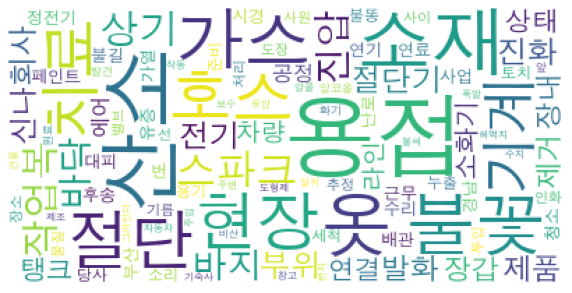

In [447]:
# wordcloud 패키지 다운로드
# !pip install wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt
nouns = []
for post in 화재_post['재해개요']:
    for noun in tagger.nouns(post):
        if noun not in list(df_stopwords.get("불용어")):
            nouns.append(noun)
num_top_nouns = 100
nouns_counter = Counter(nouns)
top_nouns = dict(nouns_counter.most_common(num_top_nouns)[:200])
print(top_nouns)

# wc = WordCloud(background_color="white", font_path='NanumBarunGothic.ttf')
wc = WordCloud(background_color="white", font_path='AppleGothic.ttf')
wc.generate_from_frequencies(top_nouns)
# World
# 많이 나타나는 단어일수록 크게 나타남

figure = plt.figure()
figure.set_size_inches(10, 10)
ax = figure.add_subplot(1, 1, 1)
ax.axis("off")
ax.imshow(wc)
wc.to_file(filename="화재_WC_ENTIRE.png") # to_file 함수
tagger = Mecab()

# posts

In [448]:
# 두번째 tokenizer(mecab)
def tokenizer_2(raw_texts, stop_words=list(df_stopwords.get("불용어"))):
    nouns = []
    for noun in tagger.nouns(raw_texts):
        if noun not in stop_words and len(noun)>1:
            nouns.append(noun)
    return nouns

print(화재_post['재해개요'].iloc[0])
print(tokenizer_2(화재_post['재해개요'].iloc[0]))

주조사업장내 가우징 작업장에서 롤초크 안쪽에 붙어있는 소착을 제거하기 위해서 가우징 기계를 이용하여 작업하던 중 가우징 불똥이 내경 단차부위에 두딪혀 작업자 쪽으로 뛰어 점퍼에 불이 붙었으나, 방독마스크와 용접면을 쓰고 있어서 불이 붙은 줄 모르다가 늦게 인지하여 왼쪽팔과 가슴쪽에 화염화상을 입음.
['주조사', '업장', '가우', '초크', '안쪽', '소착', '제거', '우징', '기계', '가우', '불똥', '내경', '단차', '부위', '점퍼', '방독', '마스크', '용접면', '인지', '가슴']


# TF-IDF

In [449]:
tfidfv = TfidfVectorizer(
    tokenizer = tokenizer_2, # 문장에 대한 tokenizer (위에 정의한 함수 이용)
    min_df = 10,            # 단어가 출현하는 최소 문서의 개수
    sublinear_tf = True,    # tf값에 1+log(tf)를 적용하여 tf값이 무한정 커지는 것을 막음
    stop_words = list(df_stopwords.get("불용어"))
)
X = tfidfv.fit_transform(화재_post['재해개요'])
X_df = pd.DataFrame(X.toarray(), columns = tfidfv.get_feature_names())
X_df # TF-IDF DTM

,가동,가스,가슴,가열,강서구,건물,건조,견해,결과,경기,...,호기,호수,호스,화기,확산,회사,후송,휘발유,흡입,히터
0,0.000000,0.000000,0.466572,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
1,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.236719,0.0,0.0,...,0.0,0.0,0.000000,0.00000,0.0,0.162817,0.0,0.0,0.0,0.0
2,0.000000,0.267763,0.000000,0.0,0.000000,0.0,0.0,0.257505,0.0,0.0,...,0.0,0.0,0.282759,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
3,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.231080,0.0,0.0,...,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
4,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.196717,0.0,0.0,...,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
935,0.232908,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.155521,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
936,0.602349,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
937,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.383538,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0
938,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0


# CountVector DTM

In [450]:
from sklearn.feature_extraction.text import CountVectorizer
countv = CountVectorizer(
                         min_df=5 # 최소 단어 등장 횟수
                        ,stop_words = list(df_stopwords.get("불용어"))
                        )
sp_mat = countv.fit_transform(sentence_list)


# 희소행렬을 np array로
count_df = pd.DataFrame(sp_mat.toarray(),columns = countv.get_feature_names())
count_df



,가공,가동,가량,가스,가스통,가슴,가열,강서구,개_,개방,...,환자,회사,회수,후송,휘발,휘발유,휴대,휴식,흡입,히터
0,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
2,0,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
935,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
936,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
937,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
938,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [451]:
# count Vector 기반 동시 단어 행렬
count_df_transpose = count_df.transpose()
count_df_transpose # 전치 행렬
count_term_document_matrix = count_df_transpose.dot(count_df) # 행렬 * 전치행렬
count_term_document_matrix # 동시 단어 행렬

,가공,가동,가량,가스,가스통,가슴,가열,강서구,개_,개방,...,환자,회사,회수,후송,휘발,휘발유,휴대,휴식,흡입,히터
가공,12,1,0,2,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
가동,1,43,5,0,0,3,0,0,0,10,...,0,0,1,0,1,0,0,0,1,0
가량,0,5,11,0,0,0,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
가스,2,0,0,204,8,1,7,2,0,15,...,1,11,10,11,2,0,7,1,7,0
가스통,0,0,0,8,7,0,0,0,0,0,...,0,3,0,2,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
휘발유,0,0,0,0,0,0,0,0,0,0,...,1,1,0,1,2,15,0,0,0,0
휴대,0,0,0,7,1,0,0,0,0,0,...,0,4,0,1,0,0,5,0,0,0
휴식,0,0,0,1,0,0,0,1,0,0,...,3,1,0,2,0,0,0,9,2,0
흡입,0,1,0,7,0,0,0,0,0,0,...,0,1,1,9,0,0,0,2,22,0


In [452]:
print(len(tfidfv.vocabulary_))

255


In [453]:
# from sklearn.metrics.pairwise import cosine_similarity
# from sklearn.metrics.pairwise import euclidean_distances

# tfidf_df = pd.DataFrame(X.toarray())
# # 2번째와 3번째 문서(유클리디안 거리 값)
# print(euclidean_distances(X[1], X[2]))#, X)
# # 2번째와 3번째 문서(코사인유사도 값)
# print(cosine_similarity(X[1], X[0]))#, X)
# # [[0.1837195]]

In [454]:
# cosine_result_df = pd.read_excel("min_df5_cos_sim.xlsx")
# cosine_result_df

In [455]:
# target = 110
# y_cosine = cosine_result_df[target - 1]
# dic ={}
# for i in range(len(y_cosine)):
#     dic[i+1] = y_cosine[i]
# #8조와 비슷한 조 찾기 위함
# # euclidean distance 를 dic에 씌워 sorting 함(1부터 10위까지)
# sorted(dic.items(), key=lambda x: x[1], reverse = True)[0:20]

In [456]:
m = TSNE(learning_rate = 50,random_state=1)
tsne_features = m.fit_transform(pd.DataFrame(X.toarray()))
tsne_features

array([[  5.990079 ,  -4.720706 ],
       [-24.832075 ,  24.813496 ],
       [-25.787302 ,  25.694883 ],
       ...,
       [-10.526059 ,  16.58543  ],
       [  1.8450358,  17.28149  ],
       [ 20.016401 ,   0.3355662]], dtype=float32)

In [457]:
df_tsne = pd.DataFrame()
df_tsne['x'] = tsne_features[:,0]
df_tsne['y'] = tsne_features[:,1]

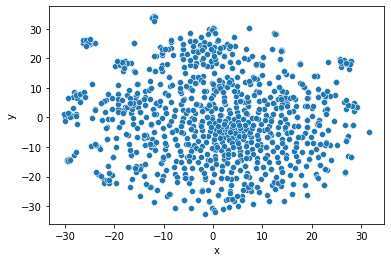

In [458]:
sns.scatterplot(x="x",y="y",data = df_tsne)
plt.show()

# Clustering

In [462]:
n_clusters = 20 ## 
kmeans = KMeans(n_clusters=n_clusters,random_state = 1)
# kmeans = KMeans(n_clusters=4,verbose = 1)
kmeans

# 모델에 fitting 하기
# kmeans.fit(tsne_features) # 축소된놈 Fitting
kmeans.fit(X.toarray()) # 축소 안한놈 Fitting
# kmeans.fit(features_kpca)

# y_kmeans = kmeans.predict(tsne_features)
y_kmeans = kmeans.predict(X.toarray())
# y_kmeans = kmeans.predict(features_kpca)

y_kmeans[0:10] # 군집화 된 결과


array([17,  6,  6,  6,  6,  6,  9,  1,  4,  9], dtype=int32)

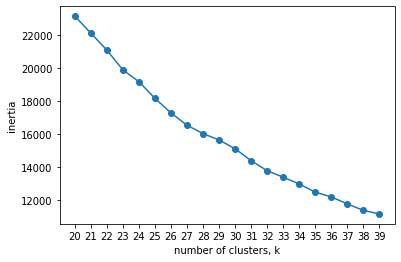

In [463]:
ks = range(20,40)

inertias = []

for k in ks:
    model = KMeans(n_clusters=k,random_state=1)
#     model.fit(X.toarray()) # 축소 안한 inertia
    model.fit(tsne_features) # tsne한 놈
    inertias.append(model.inertia_)
# Plot ks vs inertias
plt.plot(ks, inertias, '-o')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()


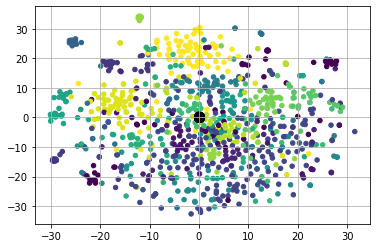

In [464]:
plt.scatter(np.array(tsne_features)[:,0], np.array(tsne_features)[:,1], c=y_kmeans, s=20, cmap='viridis')
centers = kmeans.cluster_centers_
plt.scatter(centers[:,0], centers[:,1], c='black', s=100, alpha=0.5)
plt.grid()
plt.show()

In [465]:
clustered_dic = {}
clustered_list = []
cluster_num = len(set(y_kmeans))
for idx,i in enumerate(y_kmeans):
    if i not in clustered_dic:
        clustered_dic[i] = [df_화재['연번'].iloc[idx]]
    else:
        clustered_dic[i].append(df_화재['연번'].iloc[idx])
clustered_dic
# 클러스터링이 된 패키지들
# 20개의 군집으로 생성

clustered_dic = sorted(clustered_dic.items(), key=lambda x: x[0])
df_cluster = pd.DataFrame(clustered_dic,columns=['num','clusters'])
cluster_num = [len(i) for i in df_cluster['clusters']]
df_cluster['cluster_num'] = cluster_num

df_cluster


,num,clusters,cluster_num
0,0,"[8017, 12237, 14714, 25632, 59710, 59717, 5971...",58
1,1,"[3294, 9571, 36035, 50874, 57688, 59905, 62818...",32
2,2,"[19655, 34939, 34945, 35041, 37541, 56560, 587...",41
3,3,"[22843, 29671, 29763, 29764, 29776, 29778, 297...",45
4,4,"[4276, 5927, 10759, 12264, 13071, 15093, 20055...",179
5,5,"[40730, 58215, 143751, 150192, 194931, 232717,...",16
6,6,"[636, 672, 963, 1388, 1973, 16558, 168452, 169...",12
7,7,"[16031, 40593, 40594, 42364, 71061, 83717, 854...",29
8,8,"[8391, 8527, 11593, 11605, 40814, 64690, 72914...",33
9,9,"[3112, 5113, 11409, 26226, 53811, 53831, 53832...",47


In [466]:
label = df_cluster.iloc[0].clusters
for key in df_cluster.iloc[0].clusters:

    print(df_화재[df_화재["연번"] == key]["재해개요"])

31    2011년 12월23일 10시 30분경 사천시 사남면 방지리599번지 소재하고있는 ...
Name: 재해개요, dtype: object
54    사고자 전계현은 2012.1.12, 09:30분경 당사 소재사업부 대형반 도형 작업...
Name: 재해개요, dtype: object
64    20212년 01월 27일 (20시05분경) 경남 거제시 아주1동 소재 대우조선해양...
Name: 재해개요, dtype: object
105    2012년 03월19일 (화) 13:15분경 2425호선 NO.5 D.B.W.B.T...
Name: 재해개요, dtype: object
300    2012.8.8일 오후 5시경 정읍시 소재 삼정산업 현장에서 화재로 인한 탈출시 계...
Name: 재해개요, dtype: object
301    2012.8.8일 정읍시 소재 삼정산업현장에서 화재로 인하여 계단에서 뛰어내리던중 ...
Name: 재해개요, dtype: object
302    2012.8.8일 오후 5시경 정읍시 소재 삼정산업 현장에서 화재로 인하여 계단에서...
Name: 재해개요, dtype: object
303    2012.8.8일 오후 5시경 정읍시 소재 삼정산업현장에서 화재로 인하여 계단에서 ...
Name: 재해개요, dtype: object
305    2012.8.8일 오후5시경 정읍시 소재 삼정산업 현장에서 화재로 인하여 급하게 탈...
Name: 재해개요, dtype: object
338    v2012년 9월 6일 상기 본인은 13시 40분경 실린더 라이너 주형 내부에 도형...
Name: 재해개요, dtype: object
351    경산 진량공단 소재  (주)건화틀렐러보그 도포공정에서 스프레이 작업 중 건조 시설내...
Name: 재해개요, dtype: object
378    충남 보령시 청소면 소재 ㈜함라 지붕재 생산 공정의 코팅공정에서 작업을 마치고 망인...
Name: 재해개요, dtype: object
380    

In [467]:
y_kmeans = kmeans.predict(X.toarray())
X_df['cluster'] = y_kmeans

In [468]:
total_cluster = []
total_cluster_index = []
for ci in range(0,n_clusters):
    semi_cluster= X_df[X_df['cluster']==ci]
    total_cluster_index.append(list(semi_cluster.index))
    
    cluster_sentence_list = []
    for key in semi_cluster.index:
        cluster_sentence_list.append(df_화재.iloc[key]["재해개요"])
    total_cluster.append(cluster_sentence_list)

# 동시단어행렬을 만들기 위해 cluster 별 형태로 리스트 추출

In [469]:
# 명사부분 추출
sentence_list = []
morphs_list = []
all_cluster_sentence = []
tagger = Mecab()
sentence_nouns_list = []
for clus in total_cluster:
    cluster_sentence = []
    for post in clus:
        ne = ""
        for noun in tagger.nouns(post):
            if noun not in list(df_stopwords.get("불용어")):
                if len(noun) == 1:
                        noun = noun+'_'
                        ne = ne + ' ' +noun
                else:
                    ne = ne +' '+noun
                    
        if len(ne.split()) == 1:
            continue
        cluster_sentence.append(ne)

    all_cluster_sentence.append(cluster_sentence) # 한 클러스터의 전체 단어 
all_cluster_sentence[0]

[' 용접 옷_',
 ' 권영복 니트 하부 용접 용접 불씨 주변 도통 페인트 불꽃',
 ' 용접 용접 불똥 장갑 사실 채_ 계속 불씨 장갑',
 ' 시경 진화 용화 블럭 용접 용접 불꽃 착용 자케',
 ' 기계 보수 용접 용접 불로',
 ' 용접 용접 줄_ 옷_',
 ' 물탱크 도장 용접 용접 스파크 불꽃 페인트',
 ' 용접 용접 스파크 옷_ 옷_ 진화',
 ' 물탱크 보수 공사 용접 기사 도착 담배 라이터',
 ' 정상 출근 철구 조물 프레스 용접 프레스 조립 용접 필요 구조물 용접 와중 구조물 상단 사다리 용접 가슴 위치 용접 가슴 호면 옷_ 사다리 옷_ 두건 가슴 귀_',
 ' 충북 창원군 오창읍 송대리 소재 녹십자 납품 제품 수리 요청 방문 바이오 약관 기계실 부위 발견 염상 침투 도포 실시 금이 용접 연마 용접부 염상 침투 도포 완료 용수 용접 용접 발화 탱크 스프레이 척_ 옷_ 내원 치료 호흡 중증',
 ' 기인 용접공 번_ 측면 용접 시행 용접 좌측 용접 두건 작업복',
 ' 이영 기계 당월 블록 족장 상부 용접 백_ 인화 작업복 뒤쪽 몸통',
 ' 용접 옷_ 손목',
 ' 폐유 회수 용접 유통 가스 누수 용접 발화',
 ' 유회 수통 접시 유통 가스 누수 용접 발화',
 ' 족장 하부 대유 앤지 소속 용접 산물 작업복 발화',
 ' 선_ 대경 기업 용접기 능직 사원 근무 김영진 용접 도장 완료 용접 불꽃 비산 진화 면부',
 ' 출근 장내 용접 용접 불꽃 불받이 작업복',
 ' 인천 서구 왕길동 부성 필요 용접 용접 불꽃 알코올 드럼 발화',
 ' 현장 용접 옷_',
 ' 동양 하이테크 용접 옷_',
 ' 용접 더위 절단기 산소 호스 바지 용접 불꽃 발화',
 ' 부산시 감전동 소재 대산 철강 공업 주식회사 이창길 철판 용접 불꽃 두상 목부 기름통 불꽃 기름통',
 ' 부산시 감전동 소재 대산 철강 공업 주식회사 박경수 철판 용접 불꽃 옷_ 상반신 용접 당시 기름통 불꽃 기름통',
 ' 시경 안정기 대구 지점 용접 미국 용접 용접 파타 불똥 윗

## 문서 유사도에 따른 중복 값 삭제

In [470]:
def drop_diplicate(semi_cluster):
    clean_cluster = [] 
    while semi_cluster:
        flag1 = True
        flag2 = True
        document = semi_cluster.pop(0)

        for sc in semi_cluster:
        
            score= fuzz.token_set_ratio(sc,document)
          
            if score >= 90:
 
                flag1 = False
                break

        for sc in clean_cluster:
            score= fuzz.token_set_ratio(sc,document)
            
            if score>=90:
             
                flag2 = False
                break

        if flag1==False or flag2==False:
            continue

        clean_cluster.append(document)
    return clean_cluster

# Network 시각화

In [471]:
import os
dir_name ="화재_cluster" 
try:
    os.mkdir(dir_name)
except:
    pass

In [472]:
new_cluster_length = [] # 클러스터별로 중복을 제거 했을 때, 문서 개수

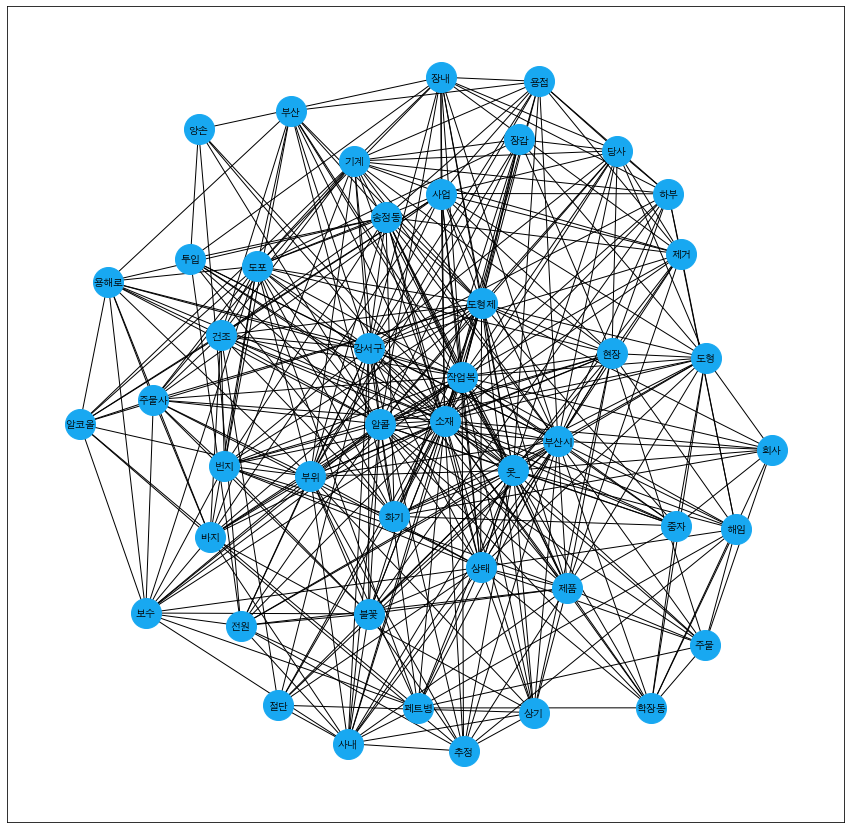

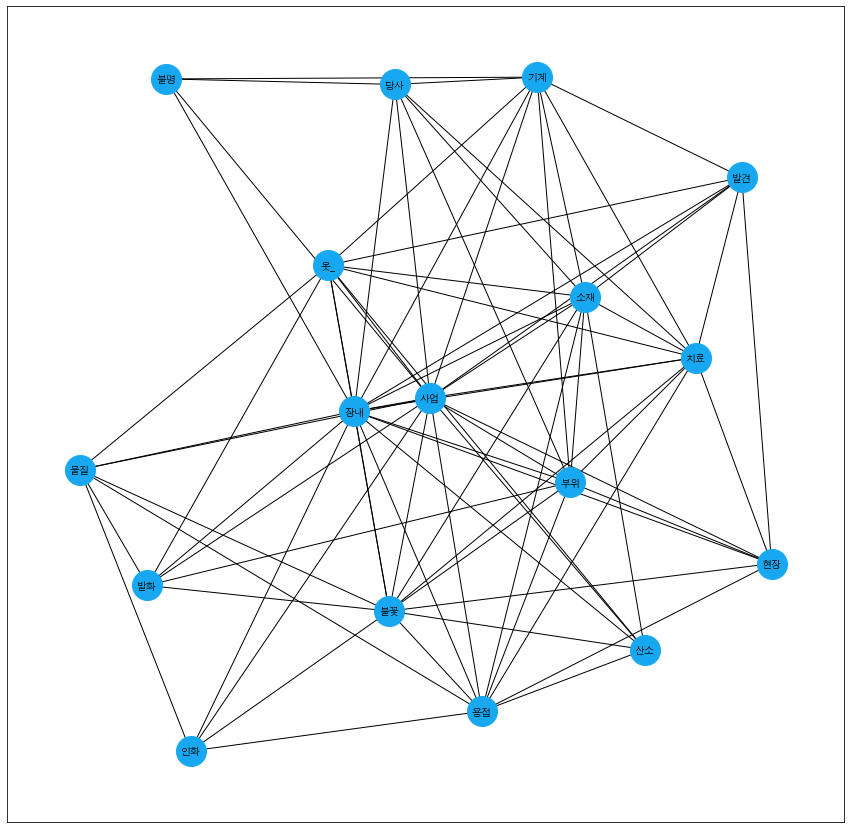

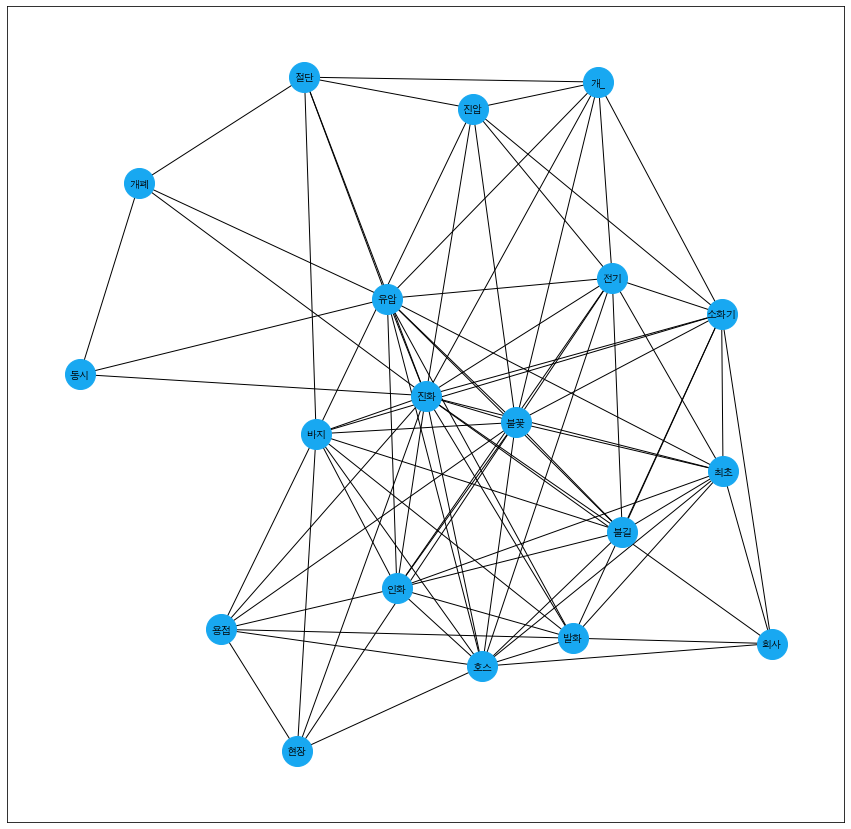

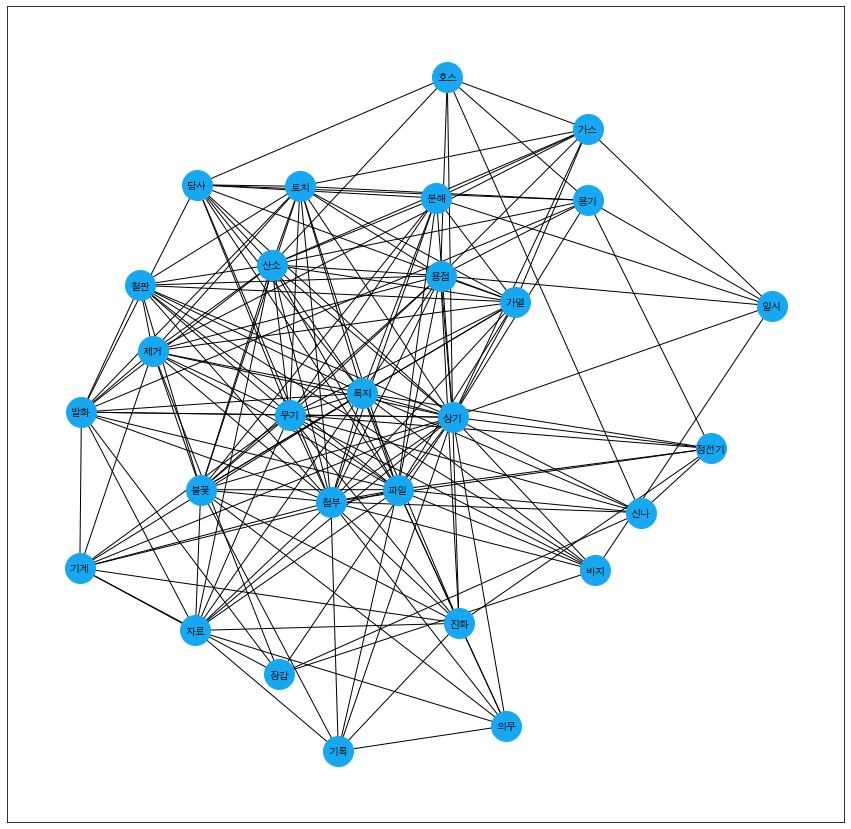

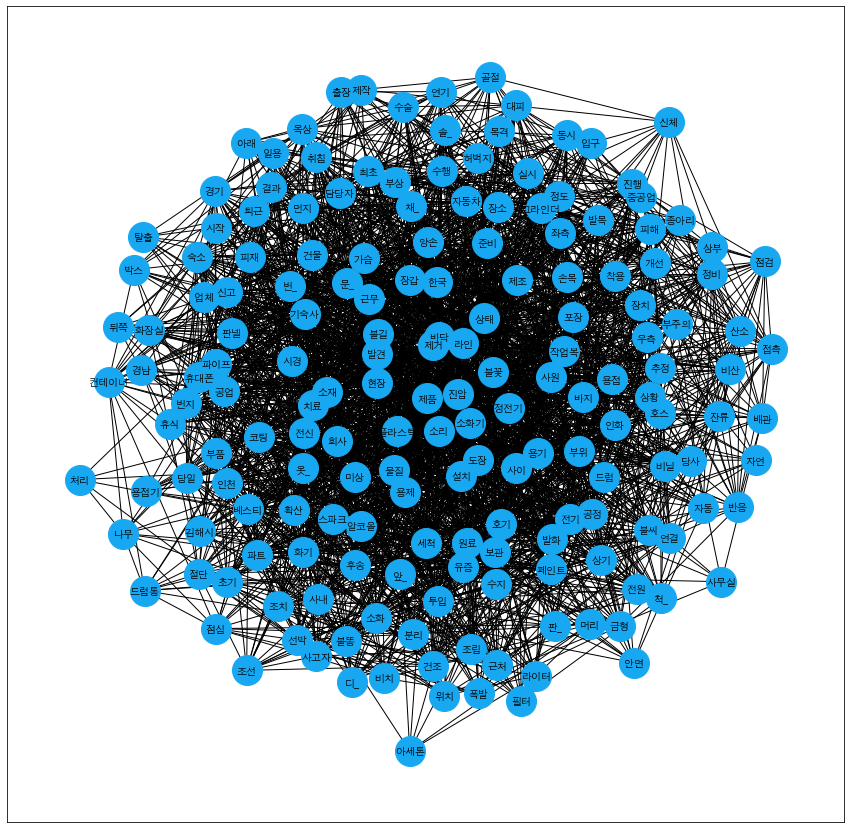

...

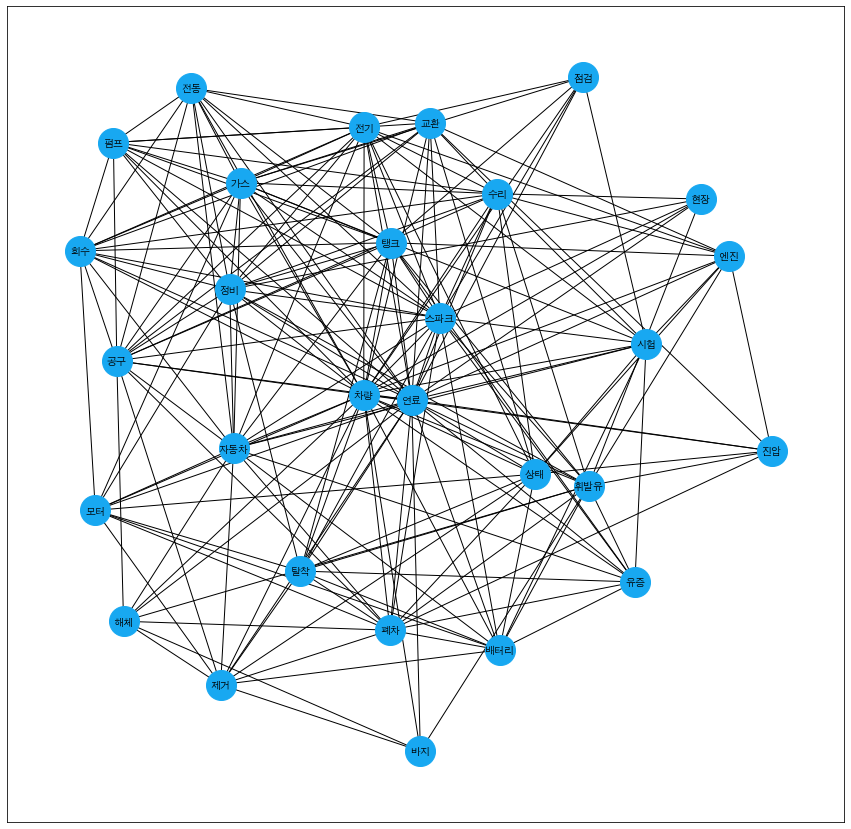

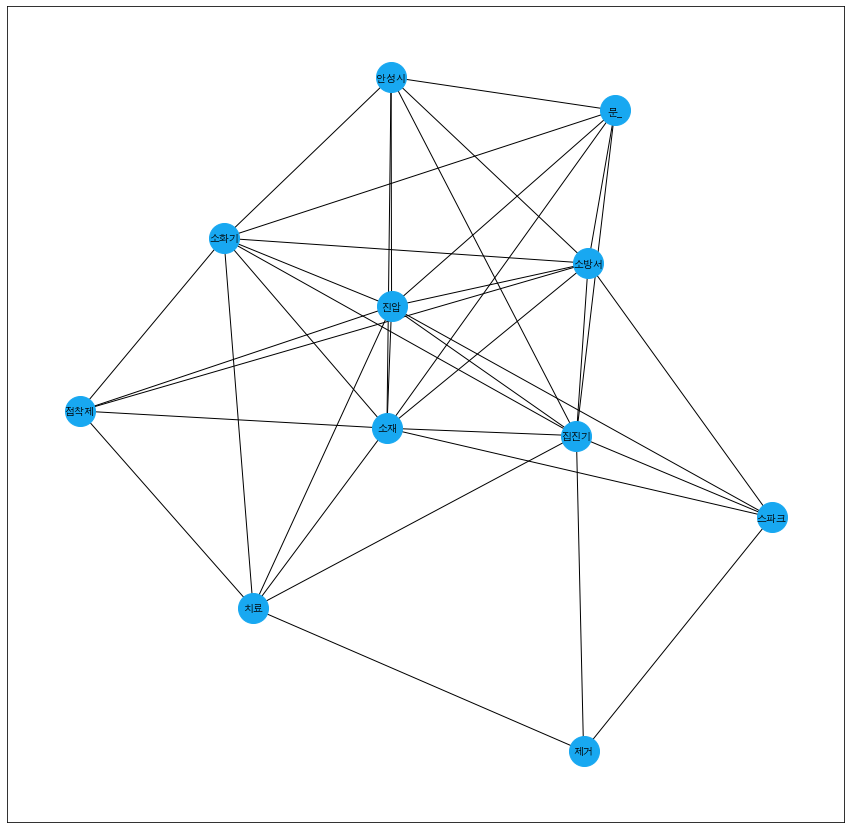

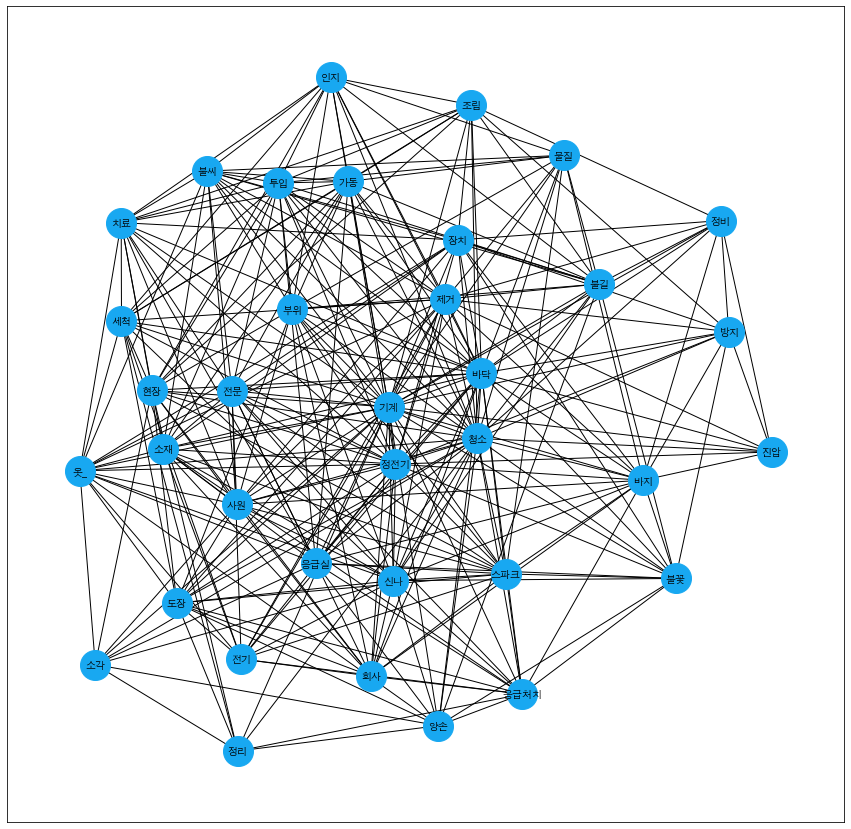

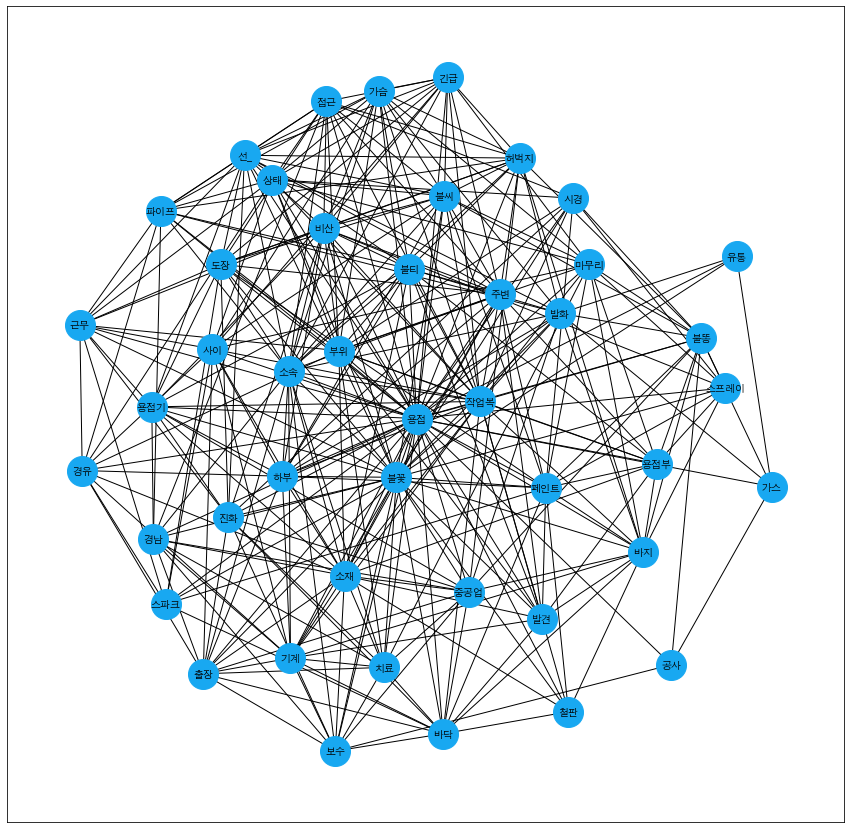

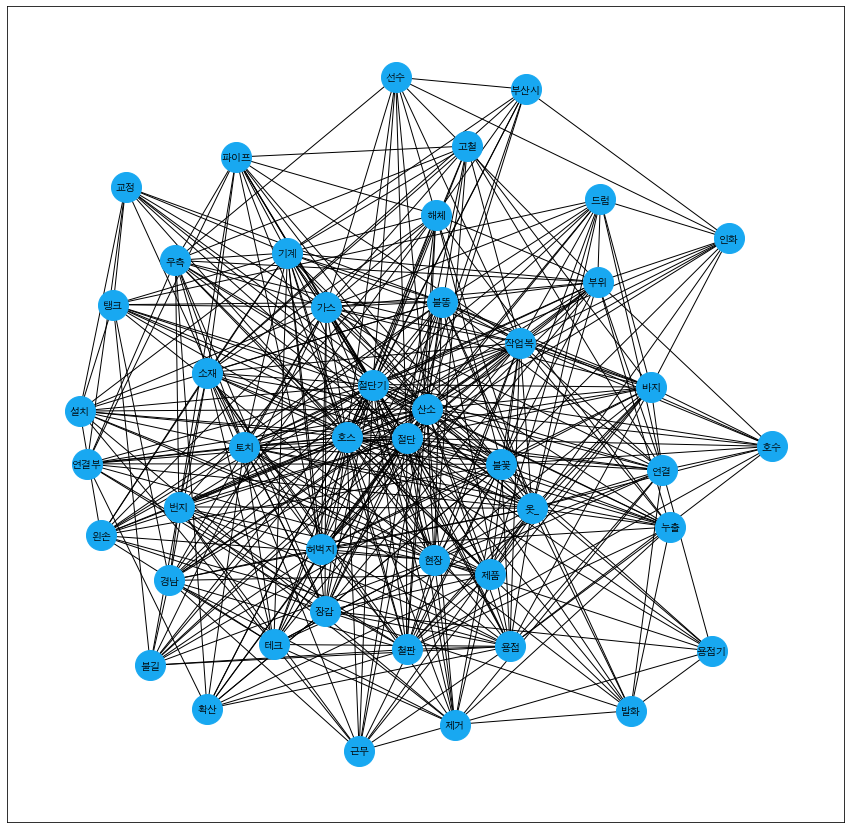

In [473]:
from collections import defaultdict
from networkx.algorithms.community import girvan_newman
from sklearn.feature_extraction.text import CountVectorizer

all_daf = []
min_df = 3
countv = CountVectorizer(
                         min_df=min_df # 최소 단어 등장 횟수
                        ,stop_words = list(df_stopwords.get("불용어"))
                        )
                             
for ci in range(n_clusters): # ci : cluster_index
    
    semi_cluster= all_cluster_sentence[ci] #cluster 별로 워드 임베딩 결과 필터링
    clean_cluster = drop_diplicate(semi_cluster)
    if len(clean_cluster)<=min_df:
        continue
#     semi_cluster.to_csv(sort_name+'_re_cluster'+str(ci)+'_re_DTM.csv',encoding='utf-8-sig') 
    new_cluster_length.append([ci,len(clean_cluster)])
    sp_mat = countv.fit_transform(clean_cluster)


    # 희소행렬을 np array로
    count_df = pd.DataFrame(sp_mat.toarray(),columns = countv.get_feature_names())
    count_df.to_csv('./'+dir_name+'/화재_DTM_cluster'+str(ci)+'.csv',encoding = 'utf-8-sig')

    # count Vector 기반 동시 단어 행렬
    count_df_transpose = count_df.transpose()
    count_df_transpose # 전치 행렬
    count_term_document_matrix = count_df_transpose.dot(count_df)  
                                       
    count_term_document_matrix.to_csv('./'+dir_name+'/화재_동시단어출현_cluster'+str(ci)+'.csv',encoding='utf-8-sig') 

    
    #네트워크 시각화를 위한 input 데이터를 만드는과정 
    dic = {}
    dic['word'] = []
    dic['toword'] = []
    dic['count'] = [] 

    count = defaultdict(int)

    idx = 1
    for col in count_term_document_matrix.columns:
        for col2 in count_term_document_matrix.columns[idx:]:
            score=count_term_document_matrix.loc[col,col2]
            if score == 0 :
                continue
#             if score<=0.80:
#                 continue
            dic['count'].append(score)

            dic['word'].append(col)
            dic['toword'].append(col2)

            count[col]+=1
            count[col2]+=1
        idx+=1
    
    all_daf.append(dic)

    daf = pd.DataFrame(dic) # dic to dataframe
    
    g = nx.from_pandas_edgelist(daf,'word','toword',)
    
    plt.figure(figsize=(15, 15))
    pos = nx.spring_layout(g,weight='count',k=1*1/np.sqrt(len(g.nodes())), iterations=50)

    pos=nx.kamada_kawai_layout(g,
    #                            dist=(2,3),
                               weight='count',
                               scale=10,
                               center=(0,5),
                               dim=2,)
    
    import matplotlib.font_manager as fm
#     font_name = fm.FontProperties(fname = 'C:/Windows/Fonts/malgunbd.ttf').get_name()
    font_name = 'AppleGothic'
    nx.draw_networkx(g, with_labels = True,
                     pos = pos,
                     node_color= '#18A8F1',
                     node_size = 900,
                     font_color ='black',
                     font_weight ='bold',
                     font_size =10,
                     font_family = font_name)
    # (g,pos,node_size=[800], node_color='pink', font_size=12,font_family='AppleGothic',)

    plt.savefig('./'+dir_name+'/화재_cluster'+str(ci)+'.png')

# plt.show()



In [474]:
new_cluster_length

[[0, 54],
 [1, 29],
 [2, 37],
 [3, 36],
 [4, 167],
 [5, 14],
 [6, 12],
 [7, 22],
 [8, 33],
 [9, 41],
 [10, 39],
 [11, 34],
 [12, 49],
 [13, 24],
 [14, 30],
 [15, 32],
 [16, 17],
 [17, 41],
 [18, 55],
 [19, 79]]

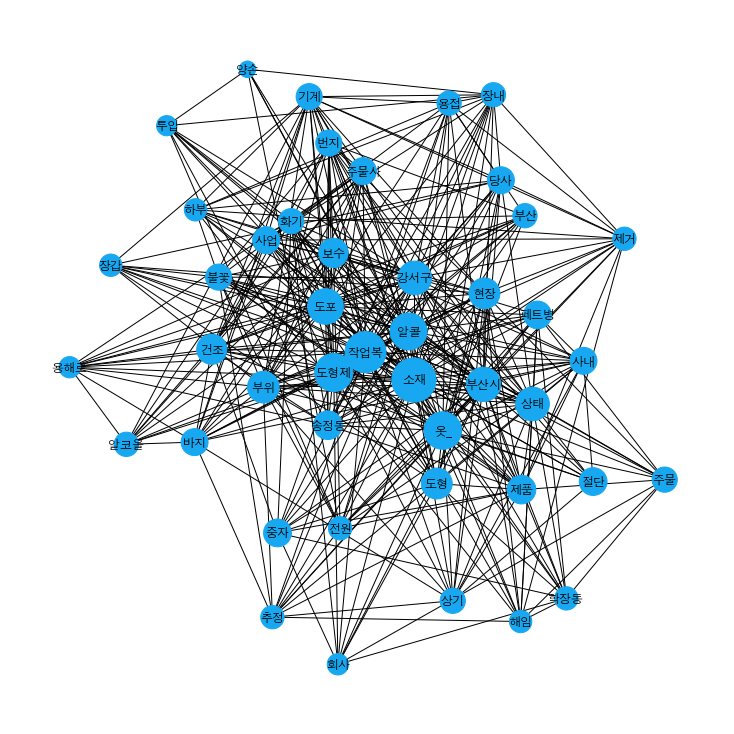

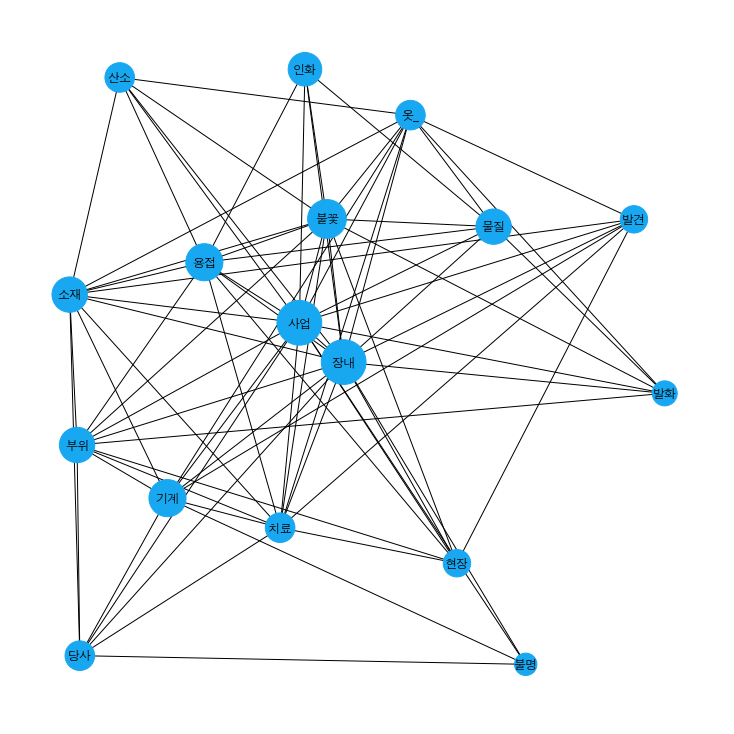

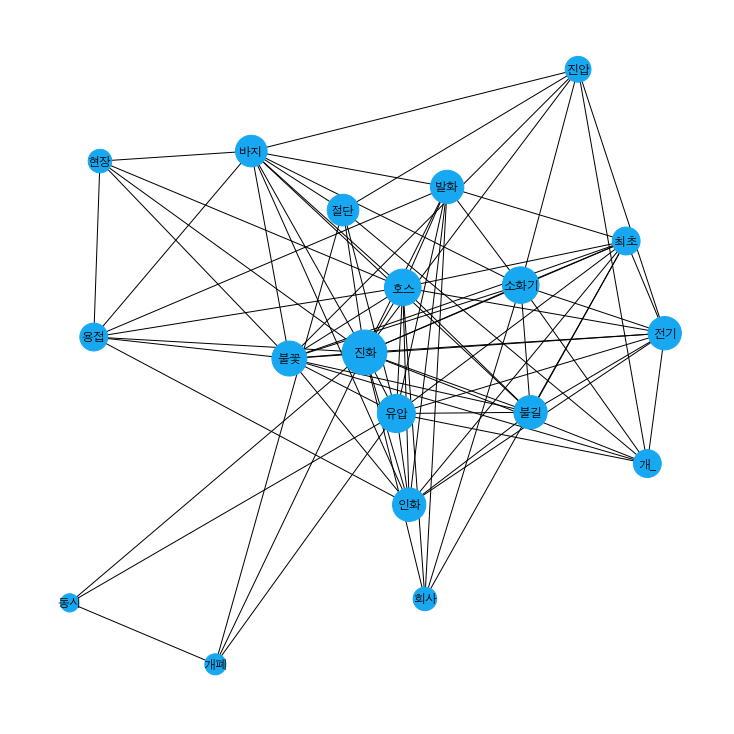

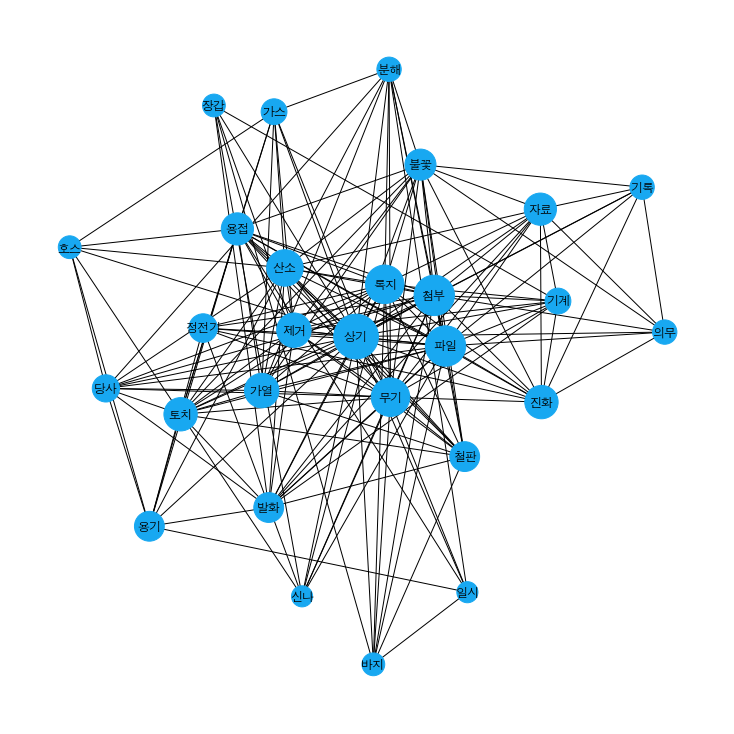

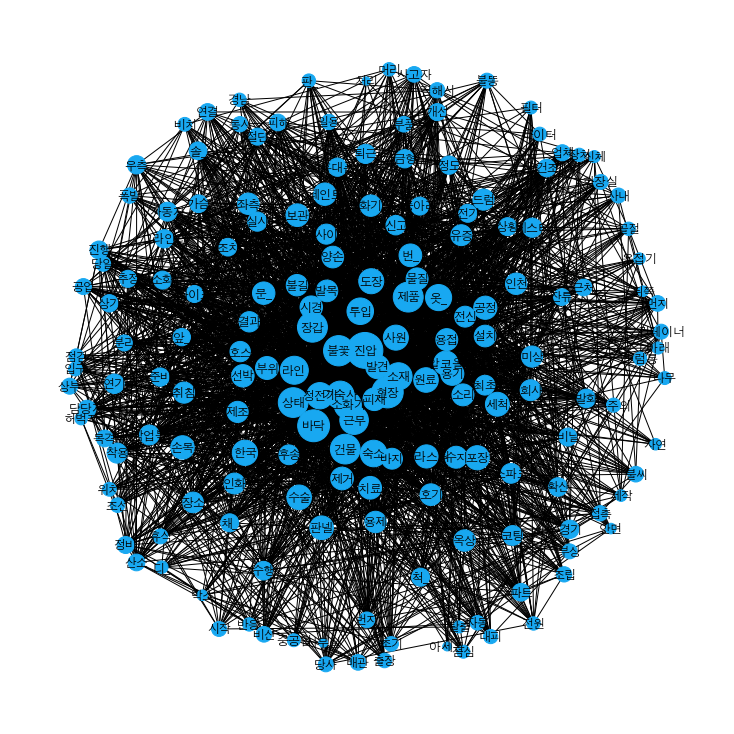

...

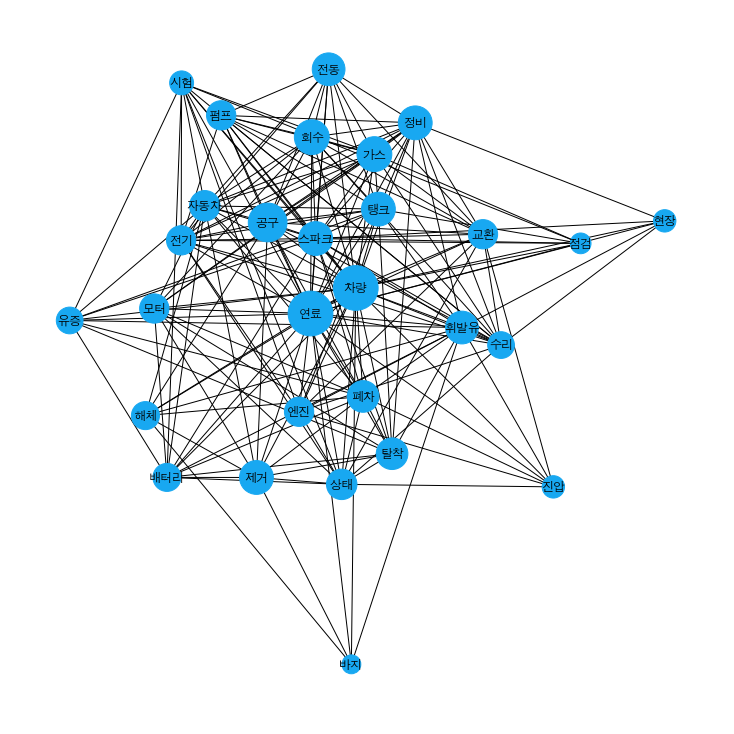

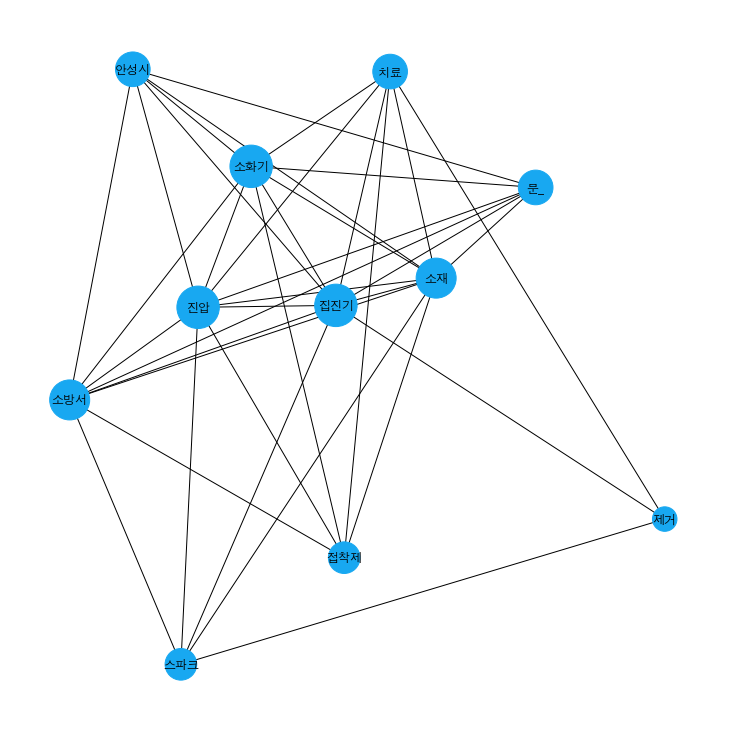

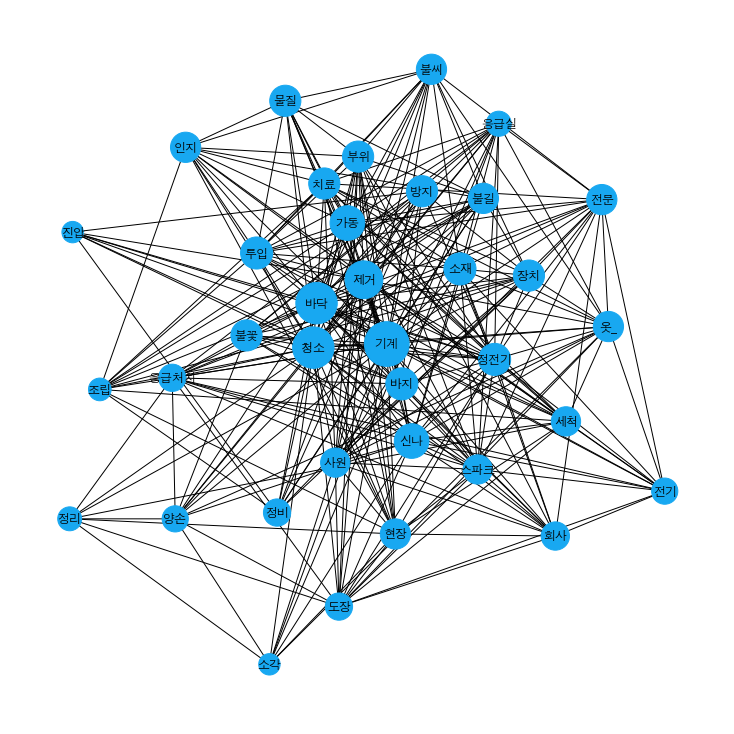

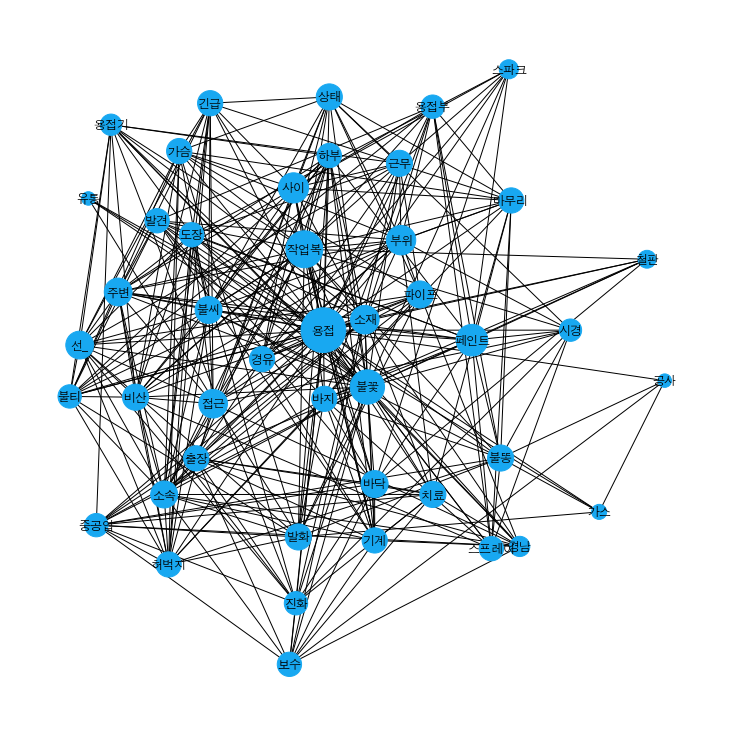

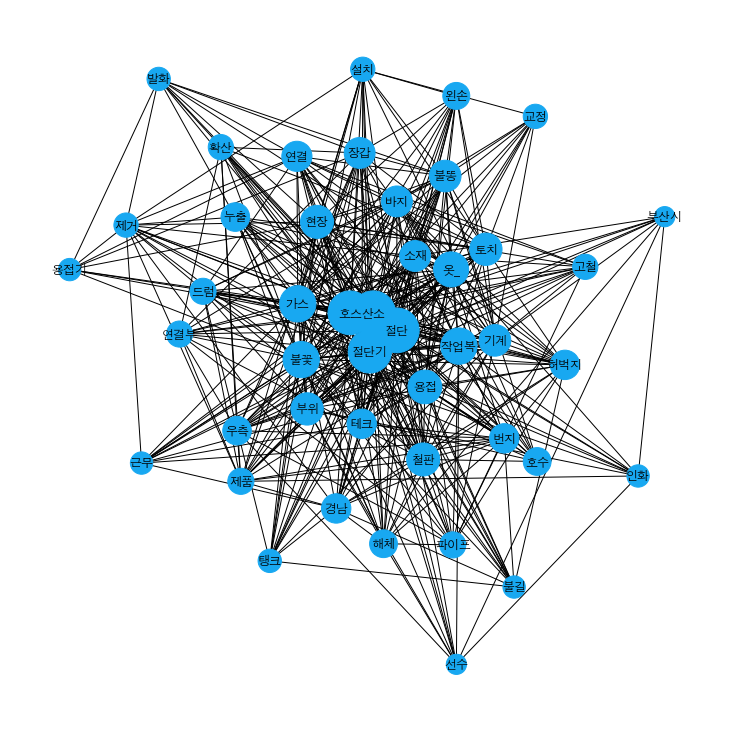

In [475]:
# -*- encoding: utf-8 -*-
import pandas as pd
import networkx as nx
import operator
import numpy as np

for ci in range(len(all_daf)):
    

    daf = pd.DataFrame(all_daf[ci]) # dic to dataframe
    
    # 단어쌍 동시출현 빈도수를 담았던 networkx.csv파일을 불러온다.

    # 중심성 척도 계산을 위한 Graph를 만든다
    G_centrality = nx.Graph()
    
#     g = nx.from_pandas_edgelist(daf,'word','toword',)

    # 빈도수가 1 이상인 단어쌍에 대해서만 edge(간선)을 표현한다.
    for ind in (list((np.where(daf['count'] > 0)[0]))):
        G_centrality.add_edge(daf['word'][ind], daf['toword'][ind], weight=int(daf['count'][ind]))

    dgr = nx.degree_centrality(G_centrality)        # 연결 중심성
#     btw = nx.betweenness_centrality(G_centrality)   # 매개 중심성
#     cls = nx.closeness_centrality(G_centrality)     # 근접 중심성
#     egv = nx.eigenvector_centrality(G_centrality)   # 고유벡터 중심성
    pgr = nx.pagerank(G_centrality)                 # 페이지 랭크

    # 중심성이 큰 순서대로 정렬한다.
    sorted_dgr = sorted(dgr.items(), key=operator.itemgetter(1), reverse=True)
#     sorted_btw = sorted(btw.items(), key=operator.itemgetter(1), reverse=True)
#     sorted_cls = sorted(cls.items(), key=operator.itemgetter(1), reverse=True)
#     sorted_egv = sorted(egv.items(), key=operator.itemgetter(1), reverse=True)
    sorted_pgr = sorted(pgr.items(), key=operator.itemgetter(1), reverse=True)

    # 단어 네트워크를 그려줄 Graph 선언
    G = nx.Graph()

    # 페이지 랭크에 따라 두 노드 사이의 연관성을 결정한다. (단어쌍의 연관성)
    # 연결 중심성으로 계산한 척도에 따라 노드의 크기가 결정된다. (단어의 등장 빈도수)
    for i in range(len(sorted_pgr)):
        G.add_node(sorted_pgr[i][0], nodesize=sorted_dgr[i][1])

#     for ind in range((len(np.where(daf['count'] >= 1)[0]))):
    for ind in (list((np.where(daf['count'] > 0)[0]))):
        G.add_weighted_edges_from([(daf['word'][ind], daf['toword'][ind], int(daf['count'][ind]))])
        
    plt.figure(figsize=(10, 10))

    # 노드 크기 조정
    sizes = [G.nodes[node]['nodesize'] * 2000 for node in G]

    options = {
        'edge_color': '#000000',
        'width': 1,
        'with_labels': True,
        'font_weight': 'regular',
    }

    # 폰트 설정을 위한 font_manager import
    import matplotlib.font_manager as fm
    import matplotlib.pyplot as plt

    # 폰트 설정
#     fm._rebuild()		# 1회에 한해 실행해준다. (폰트 새로고침, 여러번 해줘도 관계는 없다.)
#     font_fname = 'C:/Windows/Fonts/malgunbd.ttf'      # 여기서 폰트는 C:/Windows/Fonts를 참고해도 좋다.
    font_fname = 'AppleGothic'
#     fontprop = fm.FontProperties(fname=font_fname, size=30).get_name()

    nx.draw(G, node_color = "#18A8F1", 
            node_size=sizes, 
            pos=nx.spring_layout(G, k=3.5, iterations=100), 
            **options, 
            font_size =12, 
            font_family=font_fname)  # font_family로 폰트 등록
    ax = plt.gca()
    ax.collections[0].set_edgecolor("#18A8F1")
    
    plt.savefig('./'+dir_name+'/화재_중심성분석_cluster'+str(ci)+'.png')
    plt.show()

# 폭발 파열에 대한 네트워크 시각화

In [476]:
# 명사부분 추출
sentence_list = []
morphs_list = []

tagger = Mecab()
sentence_nouns_list = []
for post in 폭파_post['재해개요']:
    morphs_value = []
    for noun in tagger.nouns(post):
        if noun not in list(df_stopwords.get("불용어")):
            if len(noun) == 1:
                    noun = noun+'_'
            morphs_list.append(noun)

            morphs_value.append(noun)
    sentence_nouns_list.append(morphs_value)
sentence_nouns_list[0:10]

[['보고',
  '사유',
  '가스',
  '입실',
  '대기',
  '질소',
  '가스통',
  '체결',
  '부위',
  '불량',
  '폭발',
  '파편',
  '복부',
  '강타',
  '부상',
  '치료',
  '국민',
  '건강',
  '보험',
  '공단',
  '부당',
  '이득',
  '환수',
  '조치',
  '조사',
  '견해',
  '법_',
  '규정',
  '산업재',
  '조사표',
  '제출',
  '최근',
  '산재',
  '보고',
  '처분',
  '사실',
  '경고',
  '조치',
  '종결',
  '붙임',
  '산재',
  '경위서',
  '산업재',
  '조사표',
  '장소',
  '가수',
  '입실',
  '목적',
  '가스',
  '주입',
  '대기',
  '도구',
  '가스',
  '주입기',
  '내용',
  '대기',
  '재중',
  '사유',
  '체결',
  '부위',
  '미세',
  '불량',
  '체결',
  '분리',
  '파편',
  '복부',
  '강타'],
 ['보고',
  '사유',
  '산업재',
  '보고',
  '사실',
  '조사',
  '견해',
  '경고',
  '조치',
  '장소',
  '상기',
  '목적',
  '도구',
  '락_',
  '카통',
  '내용',
  '주의',
  '사유',
  '락_',
  '카통',
  '폭발'],
 ['보고',
  '사유',
  '실수',
  '방치',
  '담당자',
  '산재',
  '처리',
  '절차',
  '건강보험공단',
  '환수',
  '처리',
  '마무리',
  '오인',
  '조사',
  '견해',
  '정도',
  '고의',
  '판단',
  '경고',
  '조치',
  '종결',
  '장소',
  '장내',
  '목적',
  '휴식',
  '추위',
  '도구',
  '내용',
  '레기',
  '사유',
  '더미',
  '락_',
  '카_',
  '폭발'],
 ['보고',

In [477]:
# 가장많이 나오는 명사 상위 20개
from collections import Counter
num_top_nouns = 200
nouns_counter = Counter(morphs_list)
top_nouns = dict(nouns_counter.most_common(num_top_nouns)[:200])
top_nouns
# print(len(counted_nouns))

{'폭발': 645,
 '가스': 219,
 '드럼통': 198,
 '산소': 134,
 '절단': 114,
 '소재': 106,
 '탱크': 102,
 '현장': 101,
 '용접': 77,
 '용기': 73,
 '치료': 71,
 '부위': 67,
 '스프레이': 67,
 '제거': 66,
 '절단기': 65,
 '기계': 64,
 '압력': 58,
 '타이어': 55,
 '상기': 53,
 '회사': 53,
 '소리': 53,
 '파편': 51,
 '뚜껑': 51,
 '투입': 50,
 '제품': 50,
 '점검': 50,
 '유증': 50,
 '상태': 50,
 '호스': 48,
 '락_': 47,
 '드럼': 47,
 '부상': 46,
 '차량': 45,
 '전기': 42,
 '준비': 40,
 '교체': 40,
 '원료': 40,
 '수리': 40,
 '추정': 40,
 '장소': 38,
 '장내': 38,
 '진행': 38,
 '후송': 36,
 '제조': 36,
 '폭_': 35,
 '불꽃': 35,
 '에어': 34,
 '충격': 34,
 '카_': 33,
 '누출': 33,
 '사업': 33,
 '용탕': 33,
 '밸브': 33,
 '처리': 32,
 '열_': 32,
 '연결': 32,
 '당사': 31,
 '용해': 31,
 '토치': 31,
 '버너': 31,
 '바닥': 30,
 '파이프': 30,
 '위치': 30,
 '주입': 29,
 '골절': 29,
 '스파크': 29,
 '반응': 29,
 '청소': 29,
 '상부': 29,
 '사유': 28,
 '건조': 28,
 '당시': 28,
 '알루미늄': 28,
 '근무': 28,
 '용접기': 27,
 '앞_': 27,
 '설비': 27,
 '번_': 27,
 '수지': 26,
 '도장': 26,
 '공기': 26,
 '호기': 26,
 '배터리': 25,
 '상황': 25,
 '물질': 25,
 '보일러': 25,
 '시경': 25,
 '조치': 24,
 '조사': 24,
 

In [478]:
sentence_list = []
for sentence in sentence_nouns_list:
    sentence_list.append(' '.join(sentence))


{'폭발': 645, '가스': 219, '드럼통': 198, '산소': 134, '절단': 114, '소재': 106, '탱크': 102, '현장': 101, '용접': 77, '용기': 73, '치료': 71, '부위': 67, '스프레이': 67, '제거': 66, '절단기': 65, '기계': 64, '압력': 58, '타이어': 55, '상기': 53, '회사': 53, '소리': 53, '파편': 51, '뚜껑': 51, '투입': 50, '제품': 50, '점검': 50, '유증': 50, '상태': 50, '호스': 48, '락': 47, '드럼': 47, '부상': 46, '차량': 45, '전기': 42, '준비': 40, '교체': 40, '원료': 40, '수리': 40, '추정': 40, '장소': 38, '장내': 38, '진행': 38, '후송': 36, '제조': 36, '폭': 35, '불꽃': 35, '에어': 34, '충격': 34, '카': 33, '누출': 33, '사업': 33, '용탕': 33, '밸브': 33, '처리': 32, '열': 32, '연결': 32, '당사': 31, '용해': 31, '토치': 31, '버너': 31, '바닥': 30, '파이프': 30, '위치': 30, '주입': 29, '골절': 29, '스파크': 29, '반응': 29, '청소': 29, '상부': 29, '사유': 28, '건조': 28, '당시': 28, '알루미늄': 28, '근무': 28, '용접기': 27, '앞': 27, '설비': 27, '번': 27, '수지': 26, '도장': 26, '공기': 26, '호기': 26, '배터리': 25, '상황': 25, '물질': 25, '보일러': 25, '시경': 25, '조치': 24, '조사': 24, '내용': 24, '파열': 24, '공정': 24, '분진': 24, '라인': 24, '해체': 24, '업체': 24, '머리': 24, '분리': 23, '주변':

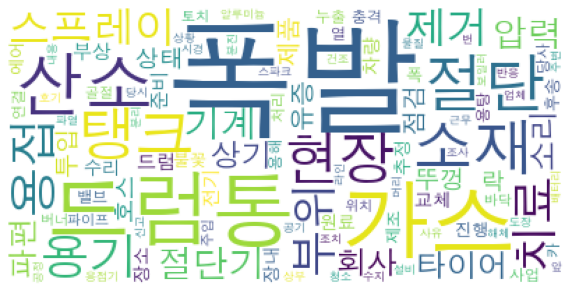

In [479]:
# wordcloud 패키지 다운로드
# !pip install wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt
nouns = []
for post in 폭파_post['재해개요']:
    for noun in tagger.nouns(post):
        if noun not in list(df_stopwords.get("불용어")):
            nouns.append(noun)
num_top_nouns = 100
nouns_counter = Counter(nouns)
top_nouns = dict(nouns_counter.most_common(num_top_nouns)[:200])
print(top_nouns)

# wc = WordCloud(background_color="white", font_path='NanumBarunGothic.ttf')
wc = WordCloud(background_color="white", font_path='AppleGothic.ttf')
wc.generate_from_frequencies(top_nouns)
# World
# 많이 나타나는 단어일수록 크게 나타남

figure = plt.figure()
figure.set_size_inches(10, 10)
ax = figure.add_subplot(1, 1, 1)
ax.axis("off")
ax.imshow(wc)
wc.to_file(filename="폭파_WC_ENTIRE.png") # to_file 함수
tagger = Mecab()

# posts

In [480]:
# 두번째 tokenizer(mecab)
def tokenizer_2(raw_texts, stop_words=list(df_stopwords.get("불용어"))):
    nouns = []
    for noun in tagger.nouns(raw_texts):
        if noun not in stop_words and len(noun)>1:
            nouns.append(noun)
    return nouns

print(폭파_post['재해개요'].iloc[0])
print(tokenizer_2(폭파_post['재해개요'].iloc[0]))

[비보고 사유] 가스주입실에서 이송대기중 질소가스통 체결부위 불량으로 폭발되면서 파편에 복부를 강타하여 부상을 입고 병원 치료를 하여 국민건강보험공단으로부터 부당이득금 환수조치된 건임 [조사자 견해] 법규정을 몰랐고 사고가 경미하여 산업재해조사표를 제출하지 않은 건으로 최근 3년이내 산재발생미보고로 처분 받은 사실이 없으므로 경고조치 후 종결코자 합니다. ※ 붙임: 산재발생미보고 경위서 및 산업재해조사표 [작업장소] 사업장 내 가수주입실 [작업목적] 가스주입 후 이동대기 중 [작업도구] 가스주입기 [작업내용] 이송대기 적재중에 [재해사유] 체결부위 미세불량으로 [재해발생] 체결이 분리되면서 파편이 복부강타
['보고', '사유', '가스', '입실', '대기', '질소', '가스통', '체결', '부위', '불량', '폭발', '파편', '복부', '강타', '부상', '치료', '국민', '건강', '보험', '공단', '부당', '이득', '환수', '조치', '조사', '견해', '규정', '산업재', '조사표', '제출', '최근', '산재', '보고', '처분', '사실', '경고', '조치', '종결', '붙임', '산재', '경위서', '산업재', '조사표', '장소', '가수', '입실', '목적', '가스', '주입', '대기', '도구', '가스', '주입기', '내용', '대기', '재중', '사유', '체결', '부위', '미세', '불량', '체결', '분리', '파편', '복부', '강타']


In [481]:
tfidfv = TfidfVectorizer(
    tokenizer = tokenizer_2, # 문장에 대한 tokenizer (위에 정의한 함수 이용)
    min_df = 10,            # 단어가 출현하는 최소 문서의 개수
    sublinear_tf = True,    # tf값에 1+log(tf)를 적용하여 tf값이 무한정 커지는 것을 막음
    stop_words = list(df_stopwords.get("불용어"))
)
X = tfidfv.fit_transform(폭파_post['재해개요'])
X_df = pd.DataFrame(X.toarray(), columns = tfidfv.get_feature_names())
X_df # TF-IDF DTM

,가동,가스,가스통,가슴,가열,강타,건물,건조,검사,견해,...,현장,호기,호스,혼합,화성시,화학,환경,환자,회사,후송
0,0.0,0.193073,0.169124,0.0,0.000000,0.282995,0.0,0.0,0.0,0.178431,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.261505,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.277026,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.223953,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
4,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.256153,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
813,0.0,0.000000,0.000000,0.0,0.606599,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
814,0.0,0.322547,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
815,0.0,0.322547,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
816,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [482]:
from sklearn.feature_extraction.text import CountVectorizer
countv = CountVectorizer(
                         min_df=5 # 최소 단어 등장 횟수
                        ,stop_words = list(df_stopwords.get("불용어"))
                        )
sp_mat = countv.fit_transform(sentence_list)


# 희소행렬을 np array로
count_df = pd.DataFrame(sp_mat.toarray(),columns = countv.get_feature_names())
count_df

# count Vector 기반 동시 단어 행렬
count_df_transpose = count_df.transpose()
count_df_transpose # 전치 행렬
count_term_document_matrix = count_df_transpose.dot(count_df) # 행렬 * 전치행렬
count_term_document_matrix # 동시 단어 행렬

,가격,가공,가동,가량,가루,가마,가스,가스통,가슴,가열,...,화성,화성시,화원,화학,환경,환자,회사,회수,후송,휴대
가격,7,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
가공,0,7,0,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
가동,0,0,29,0,2,0,12,0,0,1,...,0,0,0,0,0,5,1,0,1,0
가량,0,0,0,5,0,0,2,0,0,0,...,1,0,0,0,0,0,2,0,1,0
가루,0,0,2,0,19,0,6,0,0,0,...,0,0,0,0,0,0,1,0,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
환자,0,0,5,0,0,0,3,0,0,0,...,0,0,0,0,0,10,1,0,2,0
회사,0,0,1,2,1,0,13,0,5,0,...,0,0,0,1,0,1,61,0,13,0
회수,0,0,0,0,0,0,16,0,0,0,...,0,0,0,0,0,0,0,23,0,0
후송,0,0,1,1,3,0,15,1,5,0,...,3,1,0,0,0,2,13,0,40,0


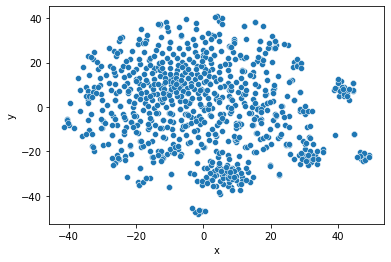

In [483]:
m = TSNE(learning_rate = 50,random_state=1)
tsne_features = m.fit_transform(pd.DataFrame(X.toarray()))
df_tsne = pd.DataFrame()
df_tsne['x'] = tsne_features[:,0]
df_tsne['y'] = tsne_features[:,1]
sns.scatterplot(x="x",y="y",data = df_tsne)
plt.show()

In [484]:
# # Silhouette score
# from sklearn.metrics import silhouette_score
# k_range=range(2,30)
# best_n=-1
# best_silhouette_score = -1
# silhouette_score_arr = []
# for k in k_range:
#     kmeans=KMeans(n_clusters=k, random_state=200)
#     kmeans.fit(X_df)
#     clusters=kmeans.predict(X_df)
#     score=silhouette_score(X_df,clusters)
#     print('k:',k,'score: ',score)
#     silhouette_score_arr.append(score)

#     if score> best_silhouette_score:
#         best_n=k
#         best_silhouette_score=score
        
# print('best_n:',best_n,'best score:',best_silhouette_score)
# silhouette_score_arr=np.array(silhouette_score_arr)



# print('best silhoutte_score : ',best_silhouette_score)
# plt.plot(k_range,silhouette_score_arr, 'o-')
# plt.title('silhouette_score')
# plt.xlabel('Number of clusters')
# plt.ylabel('silhouette_score')
# plt.show() # 22

In [485]:
n_clusters = 20
kmeans = KMeans(n_clusters=n_clusters,random_state=1)
# kmeans = KMeans(n_clusters=4,verbose = 1)
kmeans

# 모델에 fitting 하기
# kmeans.fit(tsne_features) # 축소된놈 Fitting
kmeans.fit(X.toarray()) # 축소 안한놈 Fitting
# kmeans.fit(features_kpca)

# y_kmeans = kmeans.predict(tsne_features)
y_kmeans = kmeans.predict(X.toarray())



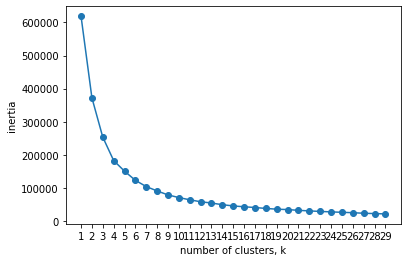

In [486]:
ks = range(1,30)

inertias = []

for k in ks:
    model = KMeans(n_clusters=k,random_state=1)
#     model.fit(X.toarray()) # 축소 안한 inertia
    model.fit(tsne_features) # tsne한 놈
    inertias.append(model.inertia_)
# Plot ks vs inertias
plt.plot(ks, inertias, '-o')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()


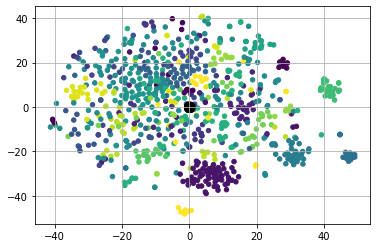

In [487]:
plt.scatter(np.array(tsne_features)[:,0], np.array(tsne_features)[:,1], c=y_kmeans, s=20, cmap='viridis')
centers = kmeans.cluster_centers_
plt.scatter(centers[:,0], centers[:,1], c='black', s=100, alpha=0.5)
plt.grid()
plt.show()

In [488]:
clustered_dic = {}
clustered_list = []
cluster_num = len(set(y_kmeans))
for idx,i in enumerate(y_kmeans):
    if i not in clustered_dic:
        clustered_dic[i] = [df_폭파['연번'].iloc[idx]]
    else:
        clustered_dic[i].append(df_폭파['연번'].iloc[idx])
clustered_dic
# 클러스터링이 된 패키지들
# 20개의 군집으로 생성

clustered_dic = sorted(clustered_dic.items(), key=lambda x: x[0])
df_cluster = pd.DataFrame(clustered_dic,columns=['num','clusters'])
cluster_num = [len(i) for i in df_cluster['clusters']]
df_cluster['cluster_num'] = cluster_num

df_cluster


,num,clusters,cluster_num
0,0,"[14151, 17615, 31390, 34236, 46937, 55607, 839...",23
1,1,"[7306, 7499, 8230, 19941, 21729, 24649, 28800,...",69
2,2,"[2545, 9595, 22367, 26906, 27331, 32318, 33536...",49
3,3,"[15013, 27178, 31727, 37830, 38033, 47429, 474...",24
4,4,"[11733, 17691, 21035, 56511, 56598, 77892, 778...",35
5,5,"[47449, 47520, 52628, 52854, 69225, 77893, 960...",29
6,6,"[26233, 30391, 32364, 56616, 63820, 84174, 857...",42
7,7,"[120, 197, 394, 478, 1525, 29429, 29520, 59769...",18
8,8,"[4892, 13336, 15004, 21991, 29074, 34549, 7895...",35
9,9,"[3420, 6352, 6916, 7407, 7826, 8806, 10323, 10...",151


In [489]:
label = df_cluster.iloc[0].clusters
for key in df_cluster.iloc[0].clusters:
    print(df_폭파[df_폭파["연번"] == key]["재해개요"])

62    2011.1.22 11시20분경 사업장 B동내에서 신나 세척작업중 용접 불똥 인화로...
Name: 재해개요, dtype: object
77    2012년2월9일 14시40분경 카본제거 작업 중 작업공구(카본제거용 스켈링 해머)...
Name: 재해개요, dtype: object
140    아침에 공장 청소후 쓰레기를 소각하기 위해서 쓰레기 소각장에 쓰레기를 소각하는 \n...
Name: 재해개요, dtype: object
156    화인테크 내 비철수집용기 제작을 위해 빈절삭유 트럼통을 절개하던 중 핸드그라인더 불...
Name: 재해개요, dtype: object
206    2012.06.15일 11시경 구사무동 2층 실험실에서 혁신팀 노원균 대리가 혼자 ...
Name: 재해개요, dtype: object
274    블록 작업중 용접 스레그 제거제에 불이 튀겨 스레거 제거가 터지는 바람에 손가락을 ...
Name: 재해개요, dtype: object
414    2012년 12월 8일 오전 10시경 현장내 청소한 쓰레기를 마당에서 소각 하던중 ...
Name: 재해개요, dtype: object
560    2013년 4월 12일 17시 40분경 경북 영천시 신녕면 치산효령로 485 소재 ...
Name: 재해개요, dtype: object
793    2013.5.6일 17시30분경 회사에서 쓰레기를 수거하여 재활용과 분리해서 소각하...
Name: 재해개요, dtype: object
799    2013.10.30.6시 아침밥을 하기 위하여 나가던 중 쓰레기가 있어 불을 붙이고...
Name: 재해개요, dtype: object
886    2014.04.07일 08시 30분 경 해남군 화산면 사포리 소재 마을 공동 소각장...
Name: 재해개요, dtype: object
988    하성1공장(하성면 원산리 597-2)본관 2층에서 2014년 8월 18일 13:30...
Name: 재해개요, dtype: object
992   

In [490]:
y_kmeans = kmeans.predict(X.toarray())
X_df['cluster'] = y_kmeans

In [491]:
total_cluster = []
total_cluster_index = []
for ci in range(0,n_clusters):
    semi_cluster= X_df[X_df['cluster']==ci]
    total_cluster_index.append(list(semi_cluster.index))

    cluster_sentence_list = []
    for key in semi_cluster.index:
        cluster_sentence_list.append(df_폭파.iloc[key]["재해개요"])
    total_cluster.append(cluster_sentence_list)

In [492]:
# 명사부분 추출
sentence_list = []
morphs_list = []
all_cluster_sentence = []
tagger = Mecab()
sentence_nouns_list = []
for clus in total_cluster:
    cluster_sentence = []
    for post in clus:
        ne = ""
        for noun in tagger.nouns(post):
            if noun not in list(df_stopwords.get("불용어")):
                if len(noun) == 1:
                        noun = noun+'_'
                        ne = ne + ' ' +noun
                else:
                    ne = ne +' '+noun
        
        if len(ne.split()) == 1:
            continue
        cluster_sentence.append(ne)
    all_cluster_sentence.append(cluster_sentence) # 한 클러스터의 전체 단어 


In [493]:
import os
dir_name ="폭발파열_cluster" 
try:
    os.mkdir(dir_name)
except:
    pass

In [494]:
new_cluster_length = []

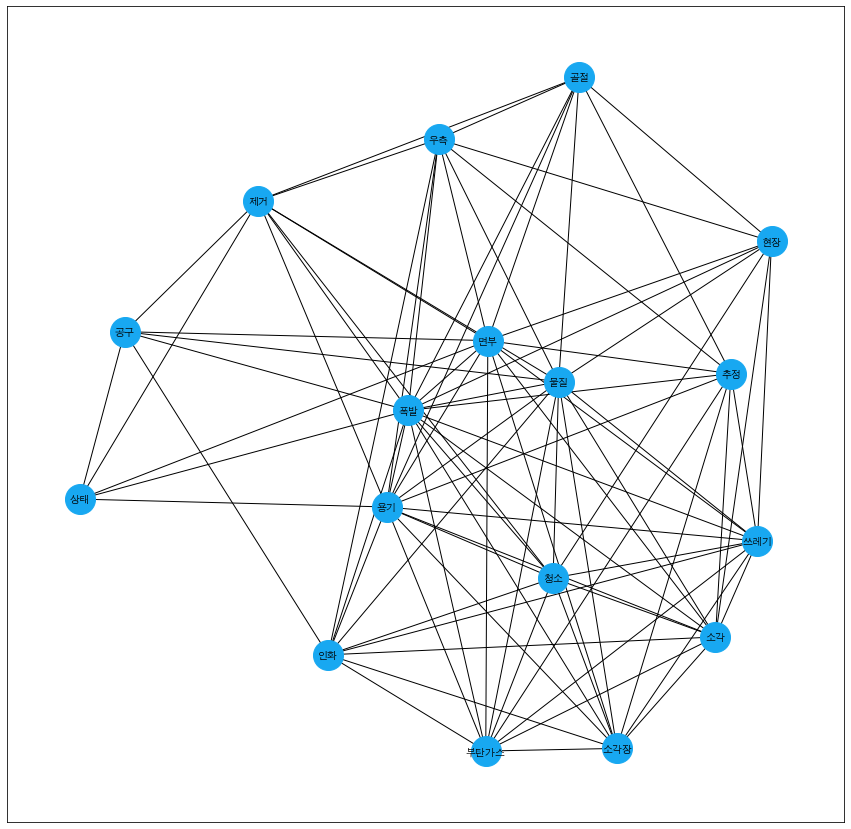

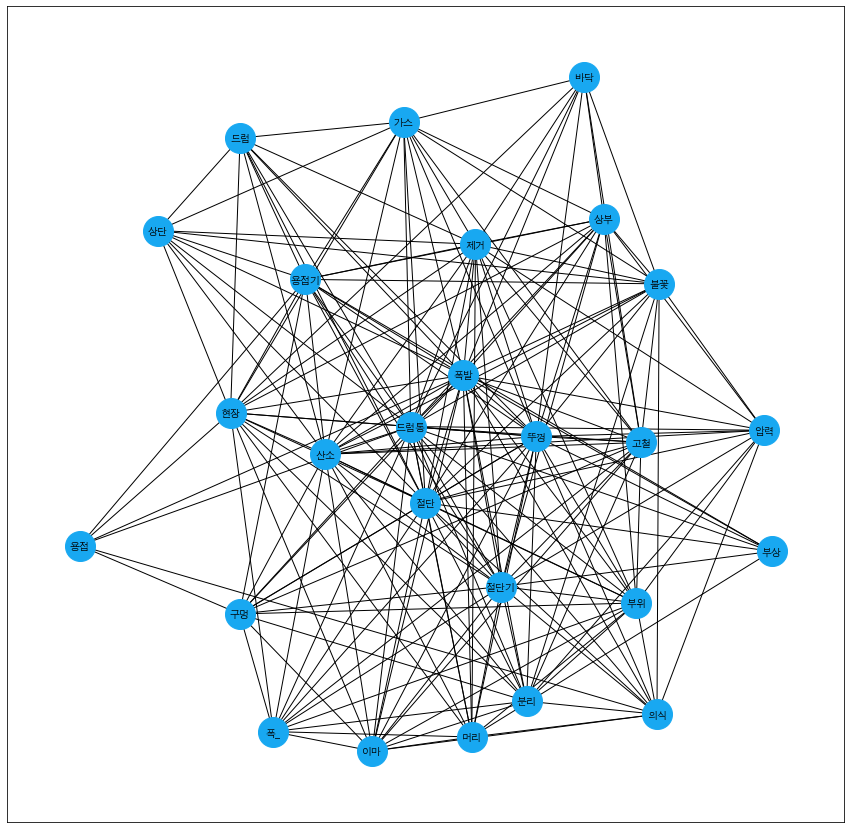

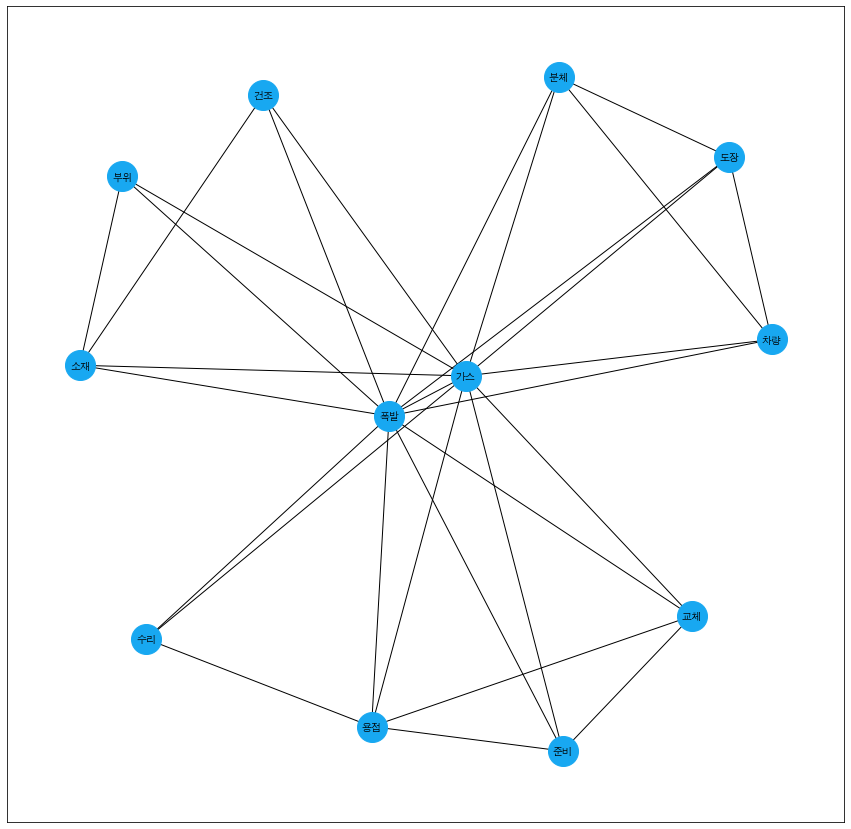

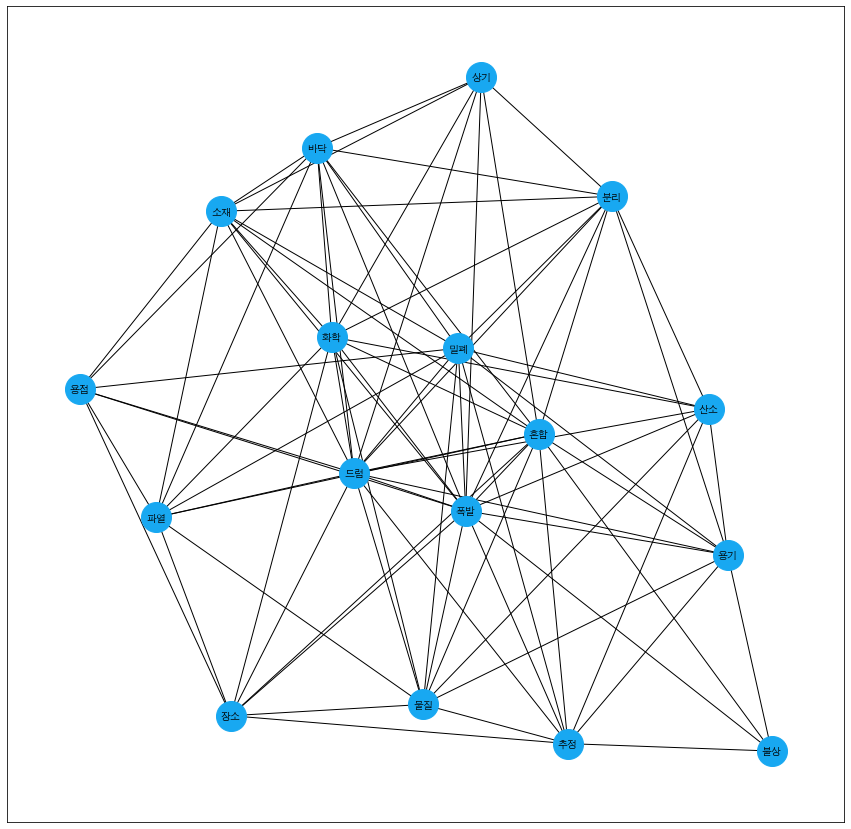

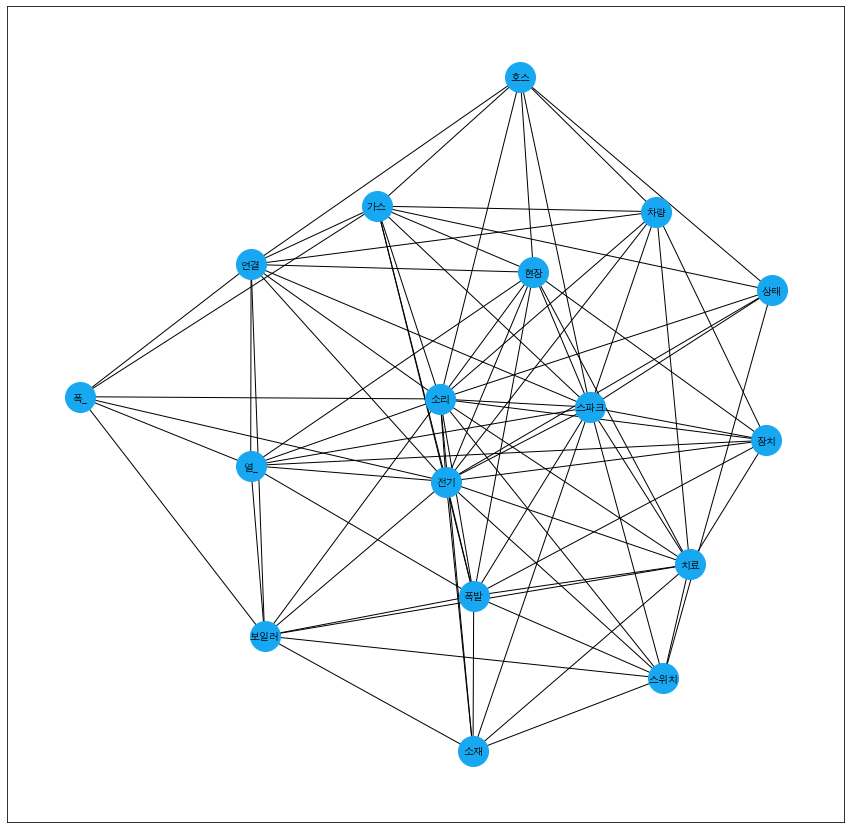

...

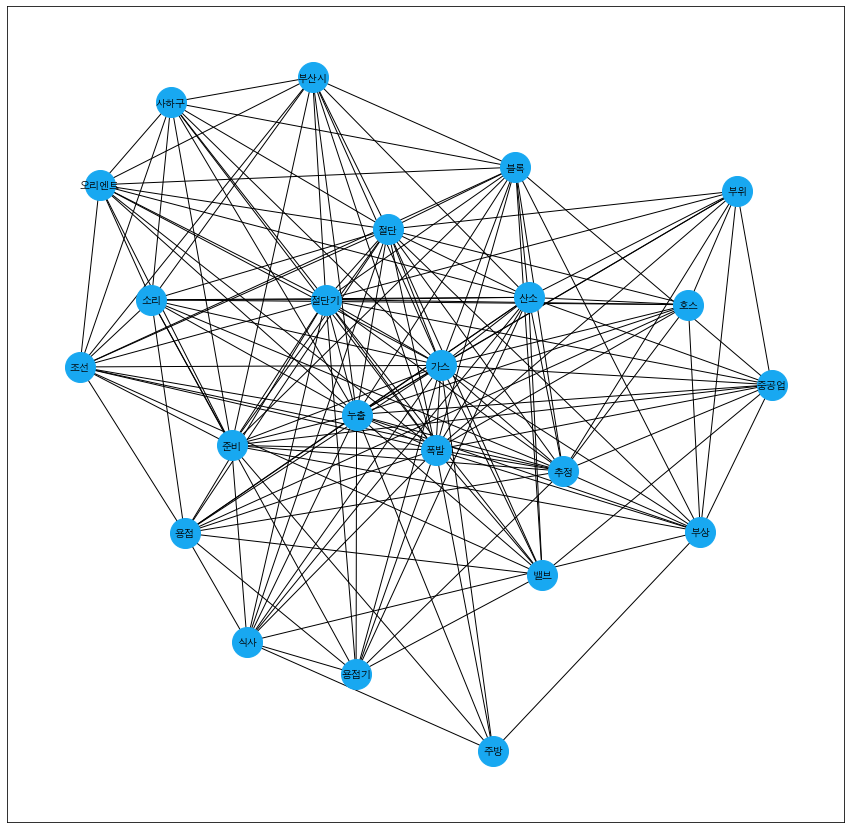

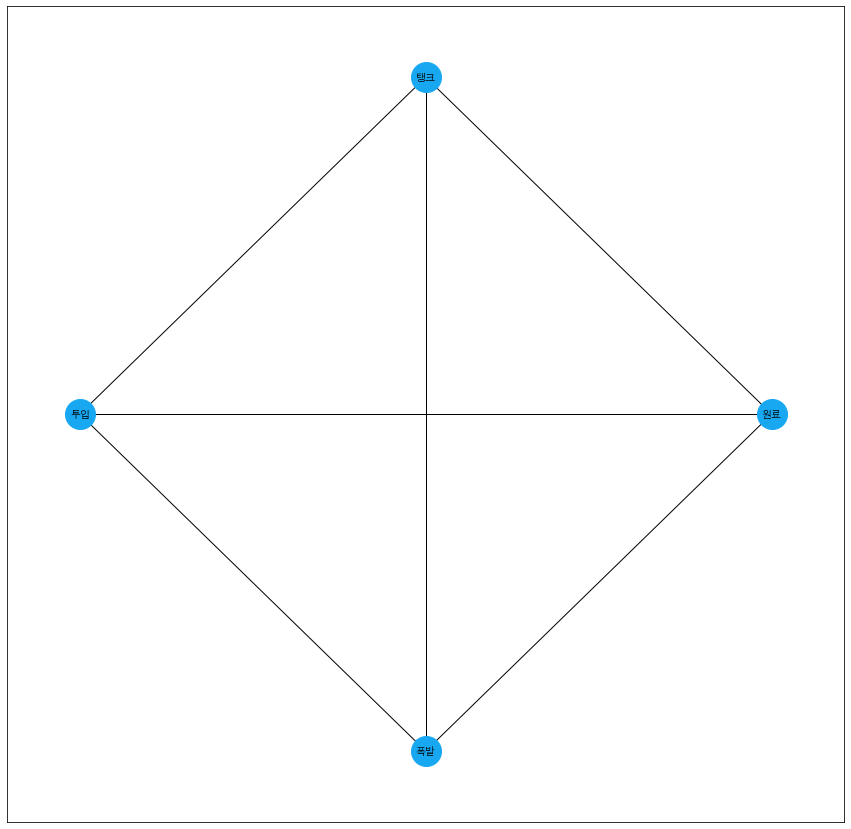

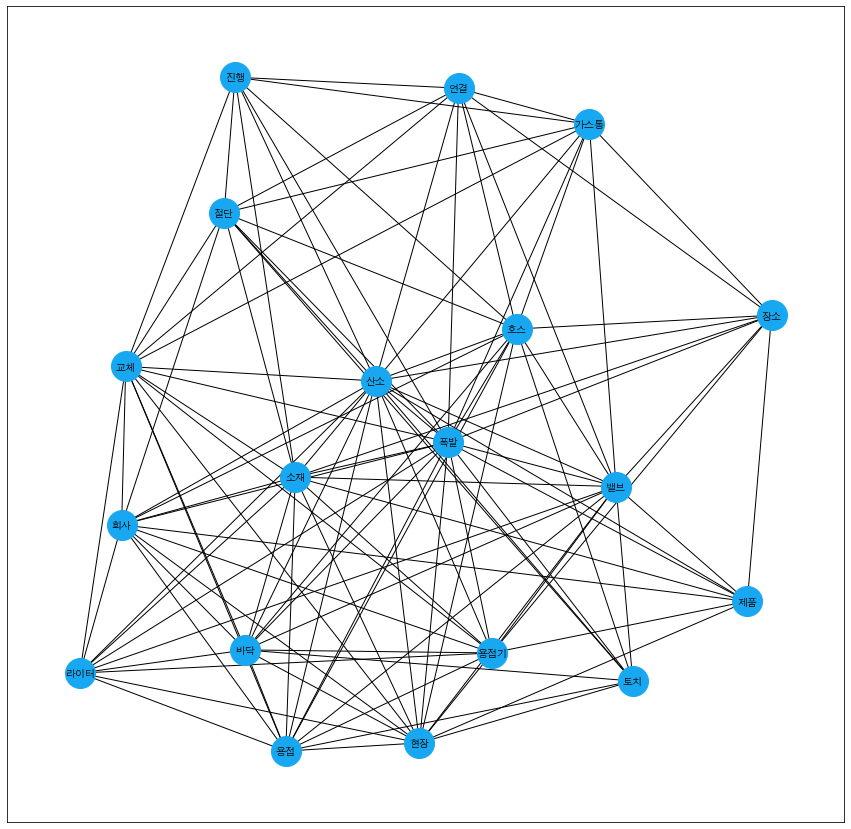

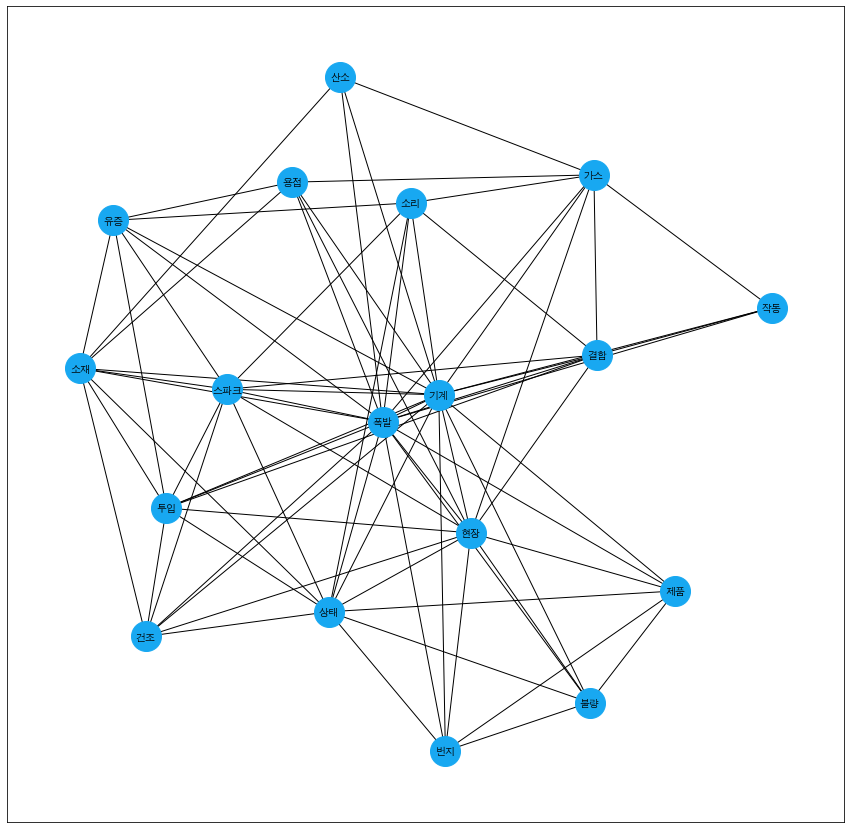

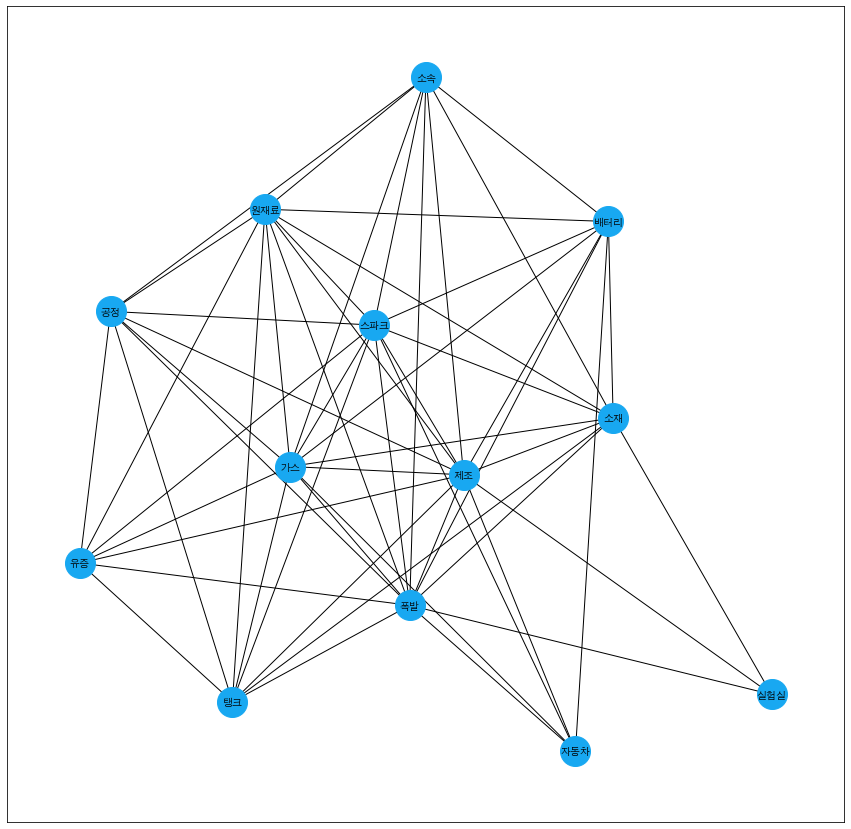

In [495]:
from collections import defaultdict
from networkx.algorithms.community import girvan_newman
from sklearn.feature_extraction.text import CountVectorizer

all_daf = []
min_df = 3
countv = CountVectorizer(
                         min_df=min_df # 최소 단어 등장 횟수
                        ,stop_words = list(df_stopwords.get("불용어"))
                        )
                             
for ci in range(n_clusters): # ci : cluster_index
    
    semi_cluster= all_cluster_sentence[ci] #cluster 별로 워드 임베딩 결과 필터링
    clean_cluster = drop_diplicate(semi_cluster)
    if len(clean_cluster)<=min_df:

        continue
#     semi_cluster.to_csv(sort_name+'_re_cluster'+str(ci)+'_re_DTM.csv',encoding='utf-8-sig') 
    new_cluster_length.append([ci,len(clean_cluster)])
    sp_mat = countv.fit_transform(clean_cluster)


    # 희소행렬을 np array로
    count_df = pd.DataFrame(sp_mat.toarray(),columns = countv.get_feature_names())
    count_df.to_csv('./'+dir_name+'/폭발파열_DTM_cluster'+str(ci)+'.csv',encoding = 'utf-8-sig')

    # count Vector 기반 동시 단어 행렬
    count_df_transpose = count_df.transpose()
    count_df_transpose # 전치 행렬
    count_term_document_matrix = count_df_transpose.dot(count_df)  
                                       
    count_term_document_matrix.to_csv('./'+dir_name+'/폭발파열_동시단어출현_cluster'+str(ci)+'.csv',encoding='utf-8-sig') 

    
    #네트워크 시각화를 위한 input 데이터를 만드는과정 
    dic = {}
    dic['word'] = []
    dic['toword'] = []
    dic['count'] = [] 

    count = defaultdict(int)

    idx = 1
    for col in count_term_document_matrix.columns:
        for col2 in count_term_document_matrix.columns[idx:]:
            score=count_term_document_matrix.loc[col,col2]
            if score == 0 :
                continue
#             if score<=0.80:
#                 continue
            dic['count'].append(score)

            dic['word'].append(col)
            dic['toword'].append(col2)

            count[col]+=1
            count[col2]+=1
        idx+=1
    
    all_daf.append(dic)

    daf = pd.DataFrame(dic) # dic to dataframe
    
    g = nx.from_pandas_edgelist(daf,'word','toword',)
    
    plt.figure(figsize=(15, 15))
    pos = nx.spring_layout(g,weight='count',k=1*1/np.sqrt(len(g.nodes())), iterations=50)

    pos=nx.kamada_kawai_layout(g,
    #                            dist=(2,3),
                               weight='count',
                               scale=10,
                               center=(0,5),
                               dim=2,)
    
    import matplotlib.font_manager as fm
#     font_name = fm.FontProperties(fname = 'C:/Windows/Fonts/malgunbd.ttf').get_name()
    font_name = 'AppleGothic'
    
    nx.draw_networkx(g, with_labels = True,
                     pos = pos,
                     node_color='#18A8F1',
                     node_size = 900,
                     font_color ='black',
                     font_weight ='bold',
                     font_size =10,
                     font_family = font_name)
    # (g,pos,node_size=[800], node_color='pink', font_size=12,font_family='AppleGothic',)

    plt.savefig('./'+dir_name+'/폭발파열_cluster'+str(ci)+'.png')

# plt.show()



In [496]:
len(all_daf)

20

0


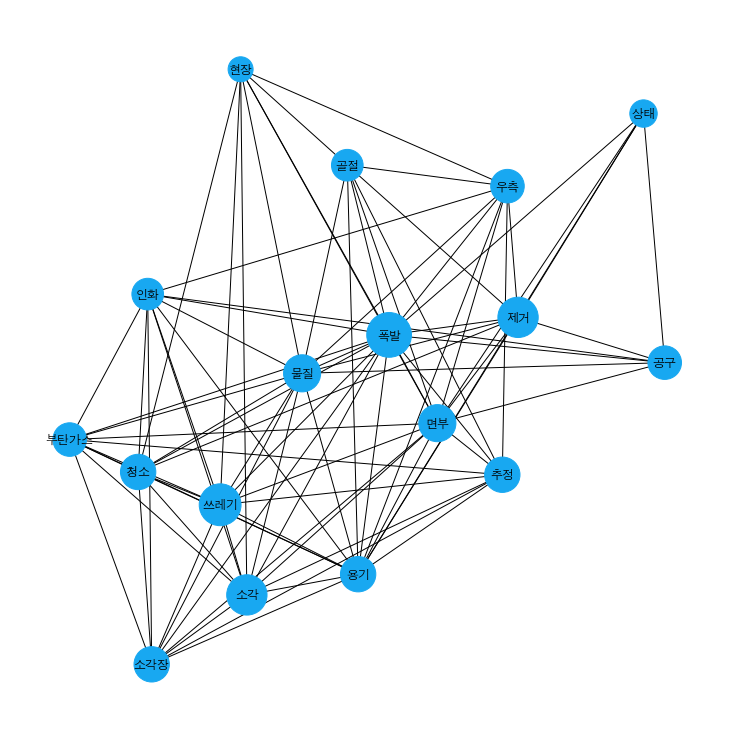

1


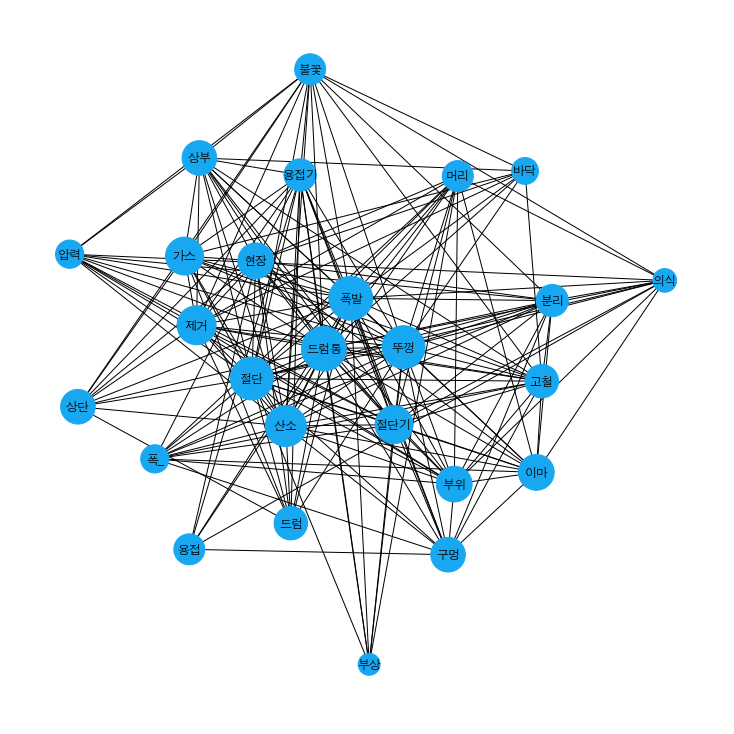

2


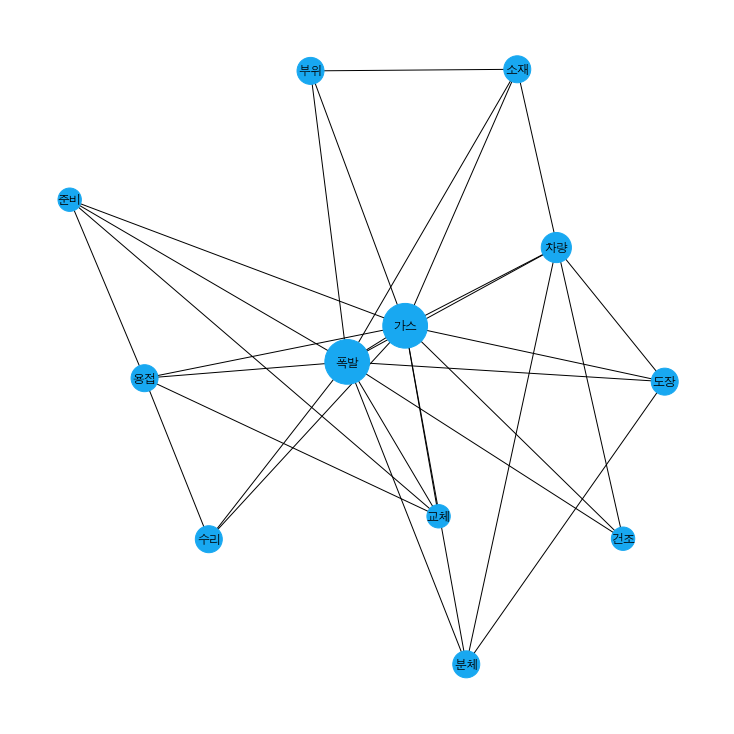

3


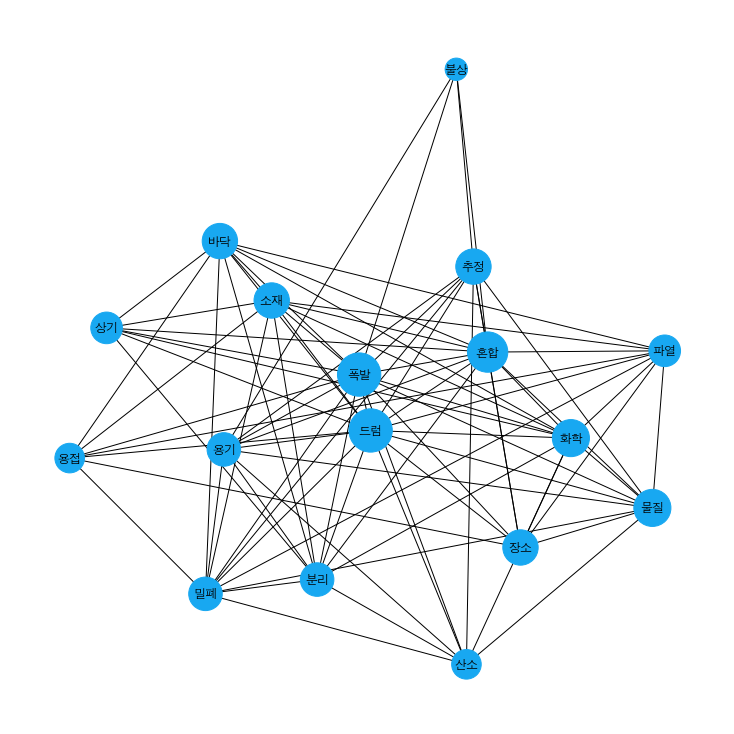

4


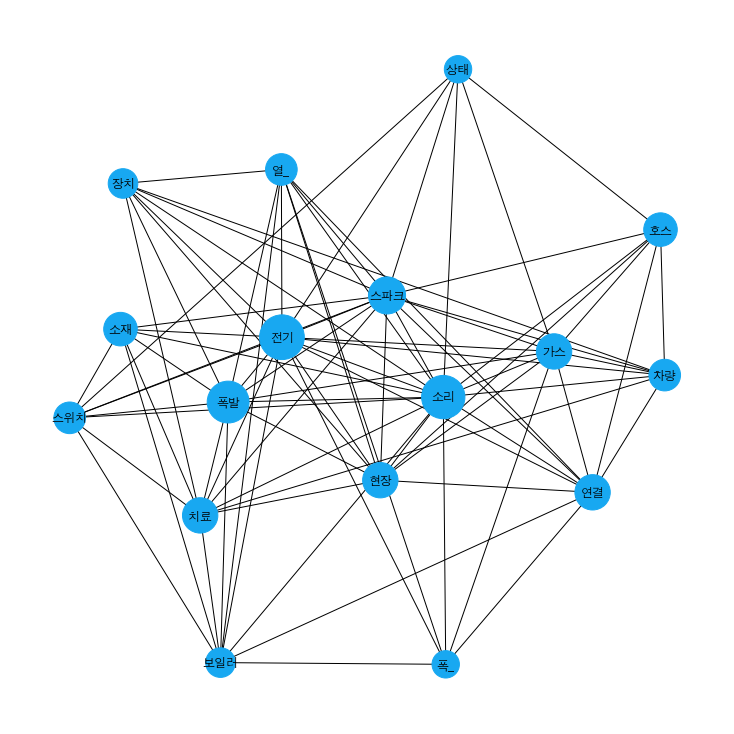

5


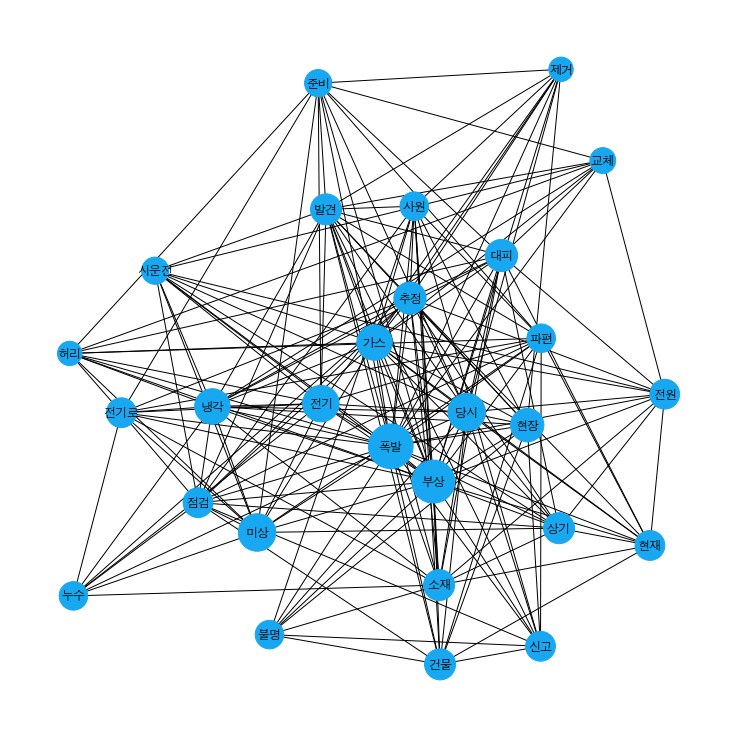

6


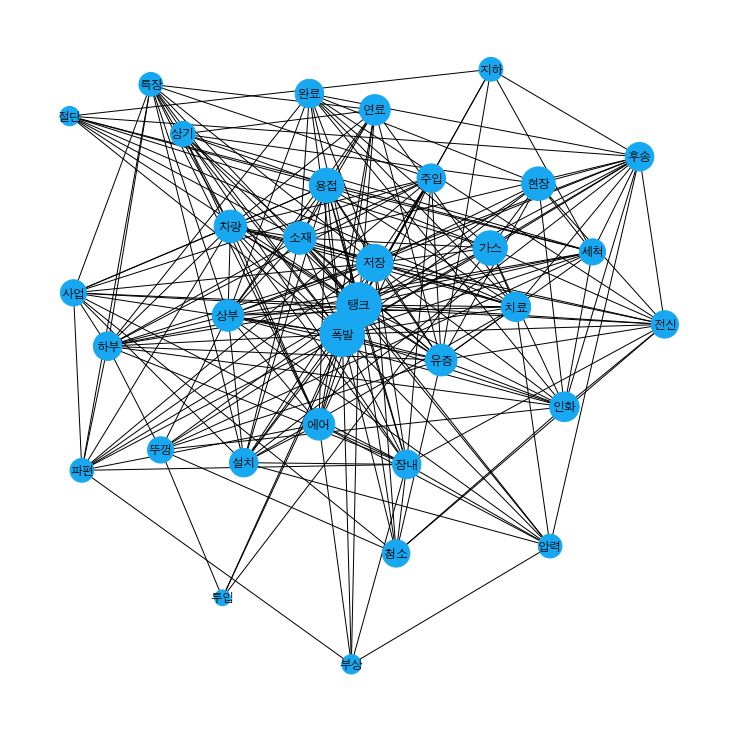

7


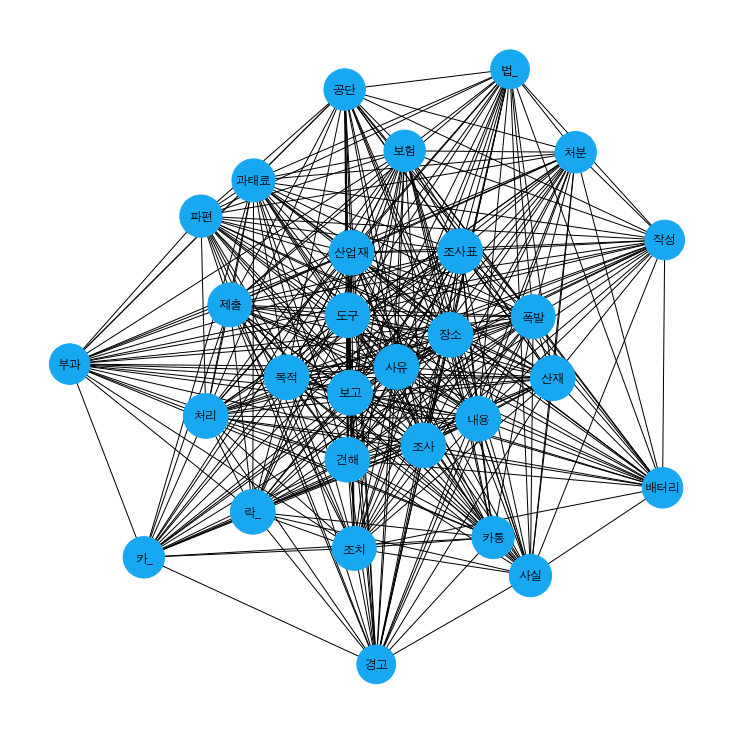

8


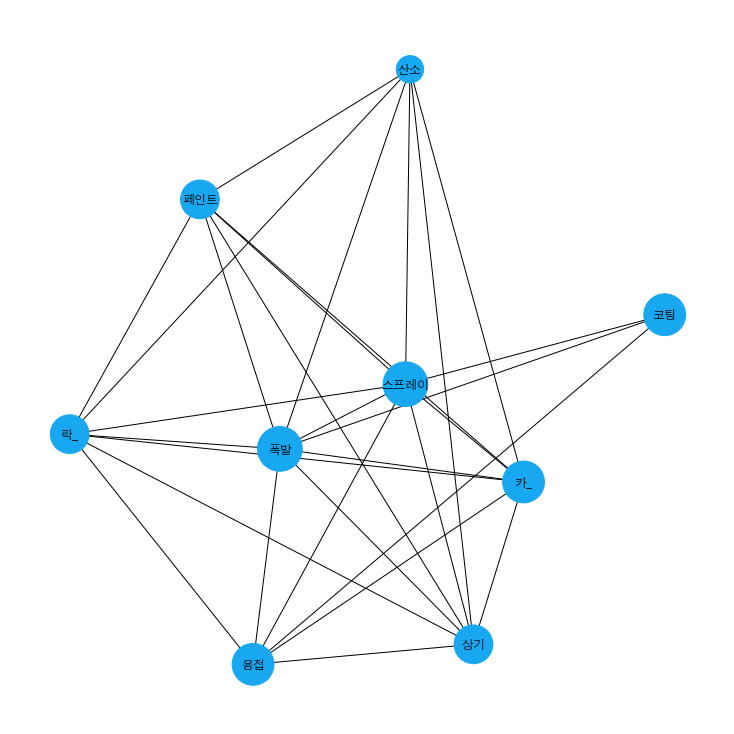

9


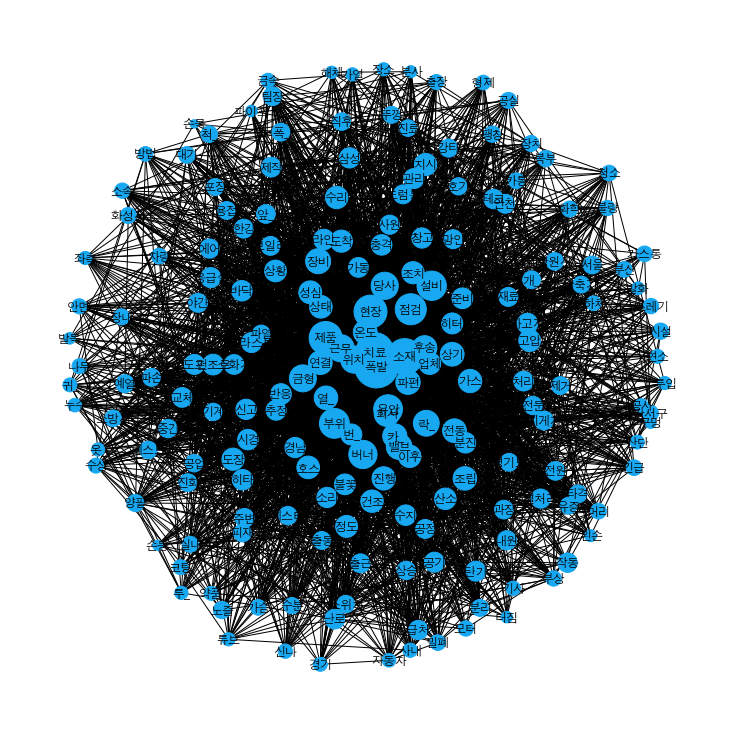

10


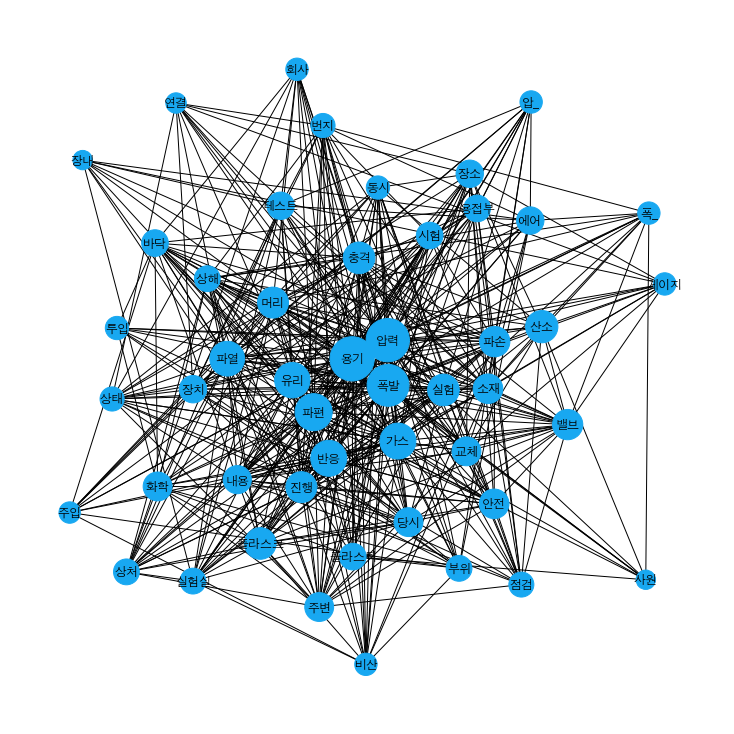

11


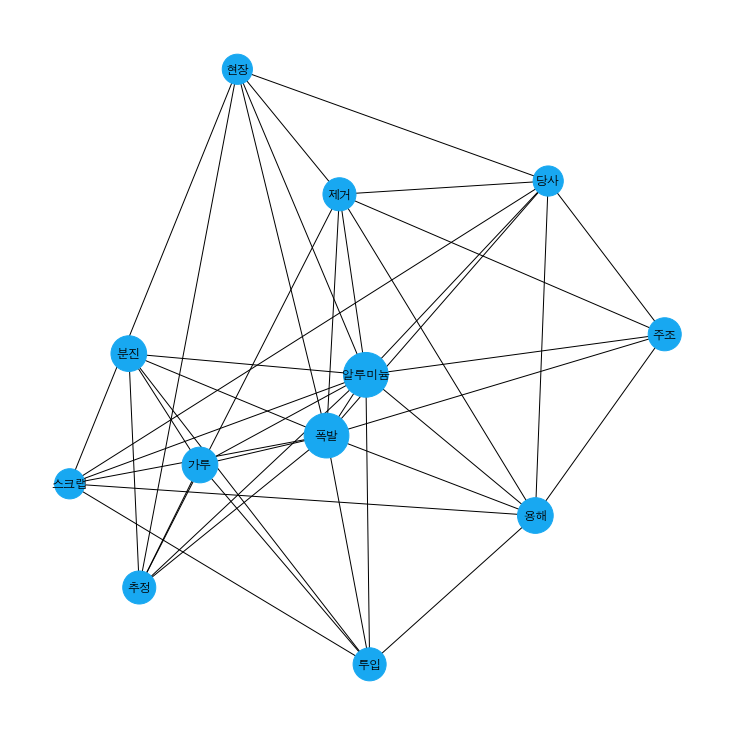

12


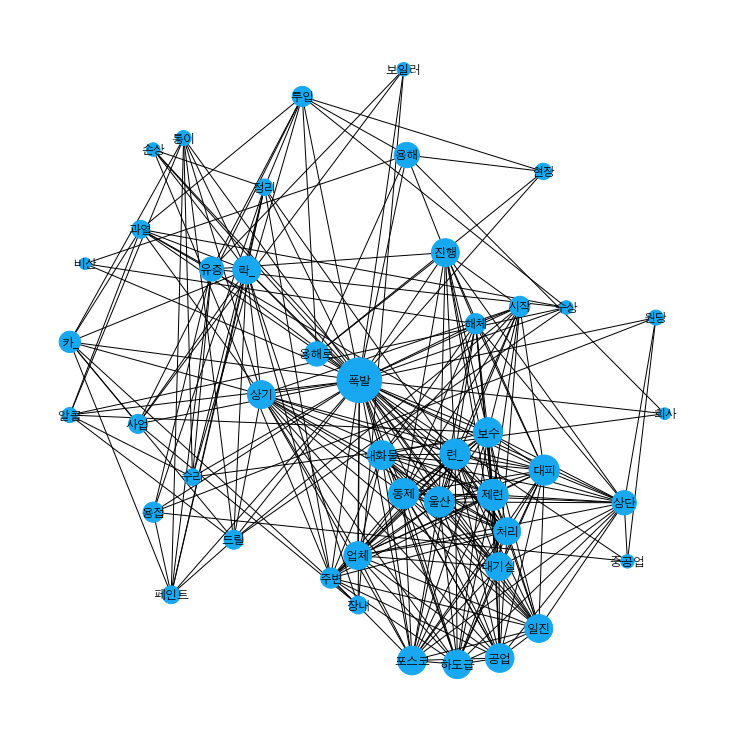

13


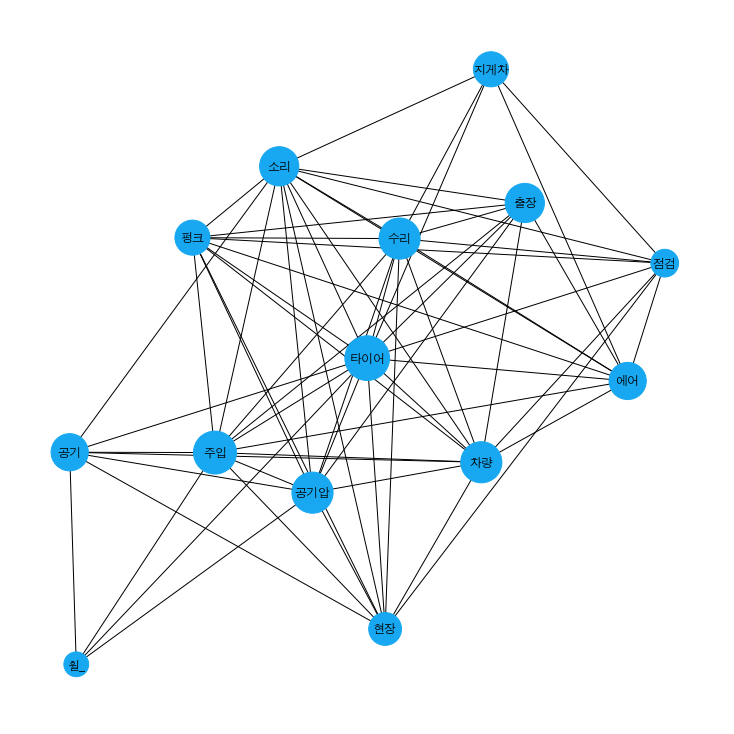

14


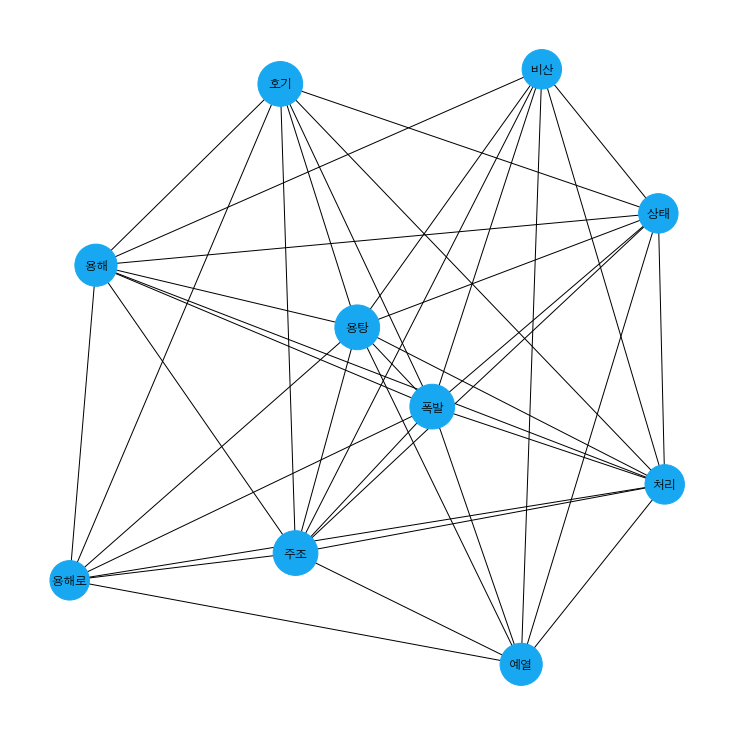

15


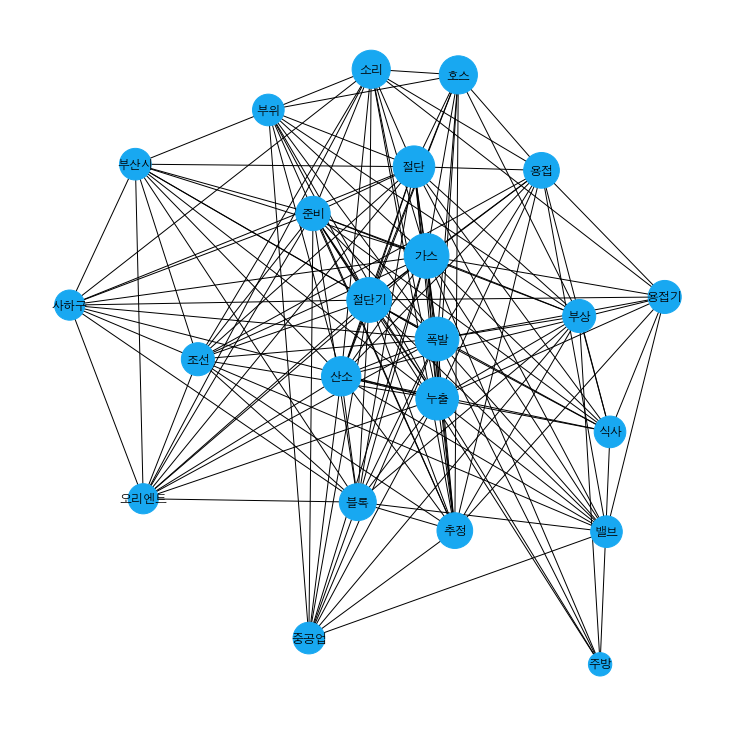

16


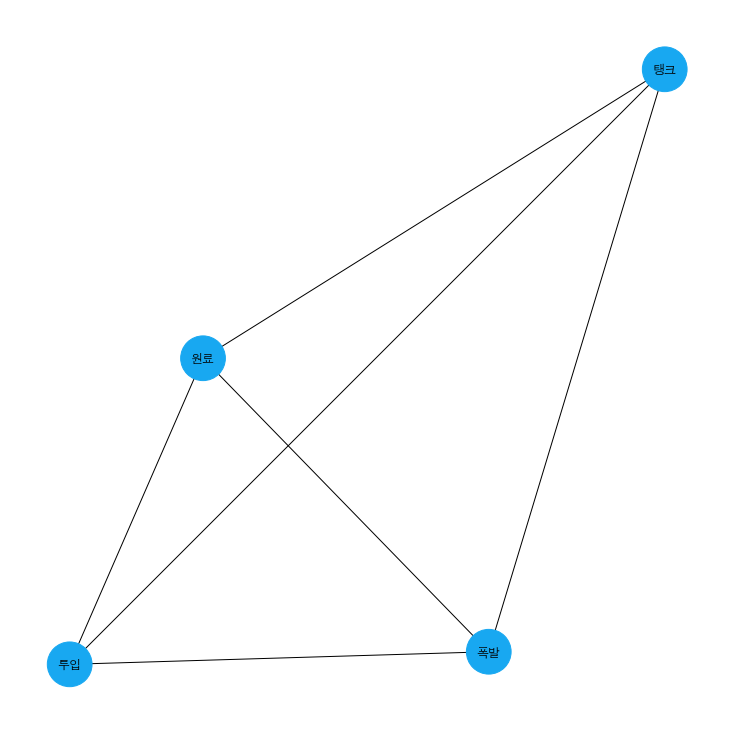

17


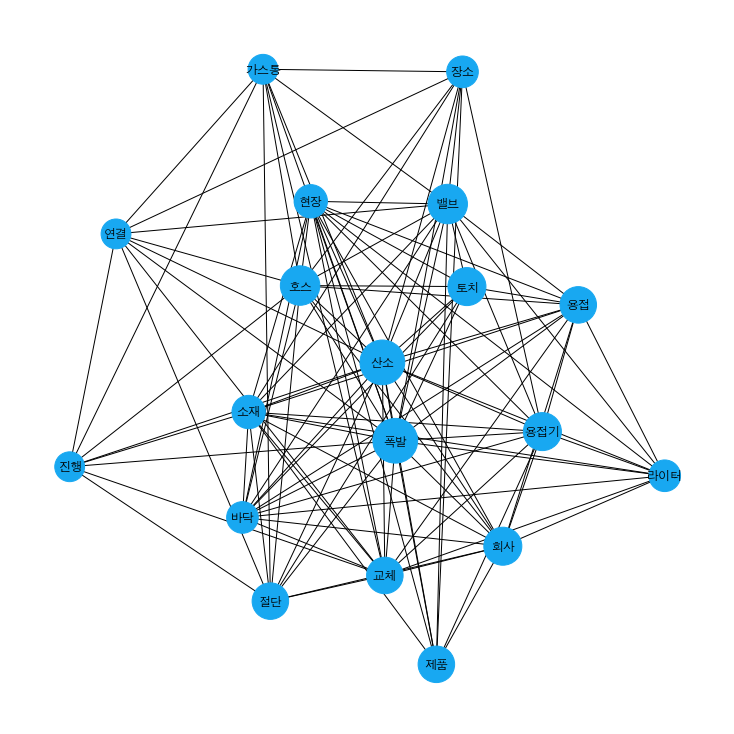

18


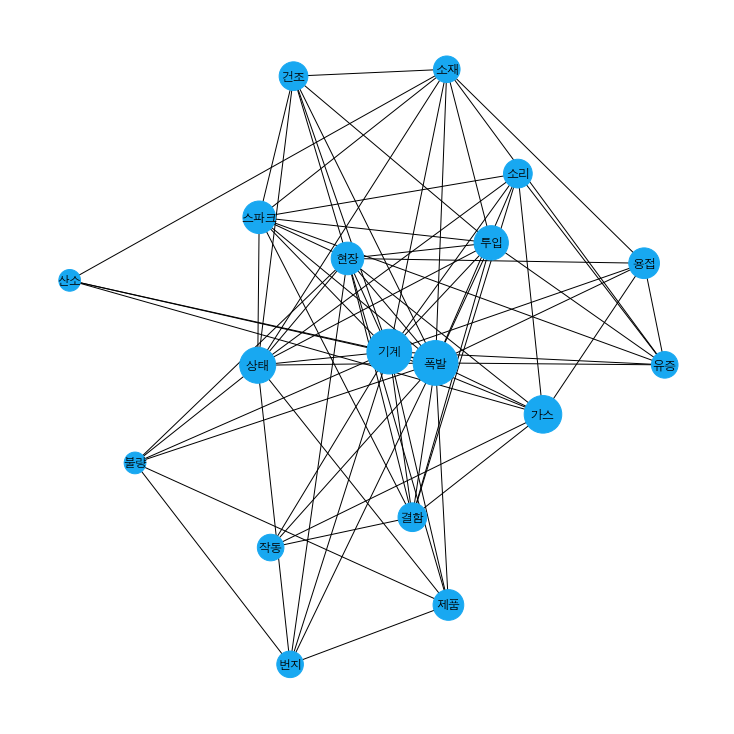

19


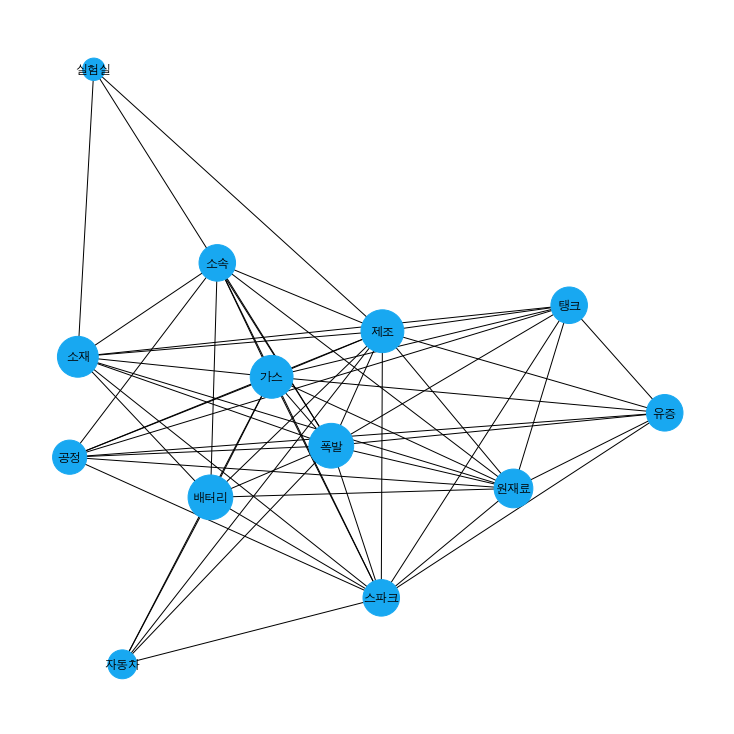

In [497]:
# -*- encoding: utf-8 -*-
import pandas as pd
import networkx as nx
import operator
import numpy as np

for ci in range(len(all_daf)):
    

    daf = pd.DataFrame(all_daf[ci]) # dic to dataframe
    print(ci)
    # 단어쌍 동시출현 빈도수를 담았던 networkx.csv파일을 불러온다.

    # 중심성 척도 계산을 위한 Graph를 만든다
    G_centrality = nx.Graph()
    
#     g = nx.from_pandas_edgelist(daf,'word','toword',)

    # 빈도수가 1이상인 단어쌍에 대해서만 edge(간선)을 표현한다.
    for ind in (list((np.where(daf['count'] > 0)[0]))):
        G_centrality.add_edge(daf['word'][ind], daf['toword'][ind], weight=int(daf['count'][ind]))

    dgr = nx.degree_centrality(G_centrality)        # 연결 중심성
    btw = nx.betweenness_centrality(G_centrality)   # 매개 중심성
    cls = nx.closeness_centrality(G_centrality)     # 근접 중심성
    egv = nx.eigenvector_centrality(G_centrality)   # 고유벡터 중심성
    pgr = nx.pagerank(G_centrality)                 # 페이지 랭크

    # 중심성이 큰 순서대로 정렬한다.
    sorted_dgr = sorted(dgr.items(), key=operator.itemgetter(1), reverse=True)
    sorted_btw = sorted(btw.items(), key=operator.itemgetter(1), reverse=True)
    sorted_cls = sorted(cls.items(), key=operator.itemgetter(1), reverse=True)
    sorted_egv = sorted(egv.items(), key=operator.itemgetter(1), reverse=True)
    sorted_pgr = sorted(pgr.items(), key=operator.itemgetter(1), reverse=True)

    # 단어 네트워크를 그려줄 Graph 선언
    G = nx.Graph()

    # 페이지 랭크에 따라 두 노드 사이의 연관성을 결정한다. (단어쌍의 연관성)
    # 연결 중심성으로 계산한 척도에 따라 노드의 크기가 결정된다. (단어의 등장 빈도수)
    for i in range(len(sorted_pgr)):
        G.add_node(sorted_pgr[i][0], nodesize=sorted_dgr[i][1])

    for ind in (list((np.where(daf['count'] > 0)[0]))):
        G.add_weighted_edges_from([(daf['word'][ind], daf['toword'][ind], int(daf['count'][ind]))])
        
    plt.figure(figsize=(10, 10))

    # 노드 크기 조정
    sizes = [G.nodes[node]['nodesize'] * 2000 for node in G]

    options = {
        'edge_color': '#000000',
        'width': 1,
        'with_labels': True,
        'font_weight': 'regular',
    }

    # 폰트 설정을 위한 font_manager import
    import matplotlib.font_manager as fm
    import matplotlib.pyplot as plt

    # 폰트 설정
#     fm._rebuild()		# 1회에 한해 실행해준다. (폰트 새로고침, 여러번 해줘도 관계는 없다.)
#     font_fname = 'C:/Windows/Fonts/malgunbd.ttf'      # 여기서 폰트는 C:/Windows/Fonts를 참고해도 좋다.
    font_name = 'AppleGothic'
#     fontprop = fm.FontProperties(fname=font_fname, size=30).get_name()

    nx.draw(G, node_color = "#18A8F1", node_size=sizes, pos=nx.spring_layout(G, k=3.5, iterations=100), **options, font_size =12, font_family=font_name)  # font_family로 폰트 등록
    ax = plt.gca()
    ax.collections[0].set_edgecolor("#18A8F1")
    
    plt.savefig('./'+dir_name+'/폭발파열_중심성분석_cluster'+str(ci)+'.png')
    plt.show()

In [498]:
new_cluster_length

[[0, 22],
 [1, 33],
 [2, 45],
 [3, 19],
 [4, 33],
 [5, 27],
 [6, 41],
 [7, 13],
 [8, 18],
 [9, 142],
 [10, 47],
 [11, 15],
 [12, 71],
 [13, 21],
 [14, 17],
 [15, 28],
 [16, 15],
 [17, 25],
 [18, 32],
 [19, 22]]